In [5]:

import umap
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
from matplotlib import rcParams
# rcParams['pdf.fonttype'] = 42 # enables correct plotting of text
rcParams['figure.figsize'] = (12,12)

In [ ]:
import sys
sys.path.append('../../../utils')
from utils import umap_refined

In [8]:
l1_colors = {
'ATL': '#1f77b4',
  'PT_VCAM1': '#c5b0d5',
 'CNT': '#ff7f0e',
 'DCT': '#279e68',
  'DCT1': '#279e68',
 'DCT2': '#ffb500',
 'DTL': '#d62728',
 'EC': '#aa40fc',
 'ENDO': '#aa40fc',
 'FIB': '#8c564b',
 'IC': '#e377c2',
 'ICA': '#e377c2',
 'ICB': '#7b4f4b',
 'IMM': '#b5bd61',
 'LEUK': '#b5bd61',
 'NEU': '#17becf',
 'PC': '#aec7e8',
 'PEC': '#17becf',
 'POD': '#98df8a',
 'PODO': '#98df8a',
'PT': '#ff9896',
 'PapE': '#c5b0d5',
 'TAL': '#c49c94',
'MES': '#f7b6d2',
 'VSM/P': '#f7b6d2','Unclassified':'#d3d3d3'}

In [9]:
l3_colors = {
'ATL': '#ffff00',
 'B': '#1ce6ff',
 'C-TAL': '#ff34ff',
 'PC': '#aec7e8',
 'CCD-IC-A': '#ff4a46',
 'CCD-PC': '#008941',
 'CNT': '#006fa6',
 'CNT-IC-A': '#a30059',
 'CNT-PC': '#ffdbe5',
 'DCT1': '#7a4900',
 'DCT2': '#0000a6',
 'DTL': '#63ffac',
 'EC-AEA': '#b79762',
 'EC-AVR': '#004d43',
 'EC-DVR': '#8fb0ff',
 'EC-GC': '#997d87',
 'EC-LYM': '#5a0007',
 'EC-PTC': '#809693',
 'FIB': '#6a3a4c',
 'IC-B': '#1b4400',
 'IMCD': '#4fc601',
 'M-FIB': '#3b5dff',
 'M-TAL': '#4a3b53',
 'MAC-M2': '#ff2f80',
 'MAST': '#61615a',
 'MC': '#ba0900',
 'MD': '#6b7900',
 'MDC': '#00c2a0',
 'MYOF': '#ffaa92',
 'N': '#ff90c9',
 'NEU': '#b903aa',
 'NKC/T': '#d16100',
 'OMCD-IC-A': '#ddefff',
 'OMCD-PC': '#000035',
 'PEC': '#7b4f4b',
 'PL': '#a1c299',
 'POD': '#300018',
 'PT-S1/2': '#0aa6d8',
 'PT-S3': '#013349',
 'PapE': '#00846f',
 'REN': '#372101',
 'T': '#ffb500',
 'VSMC': '#c2ffed',
 'VSMC/P': '#a079bf',
 'aFIB': '#cc0744',
 'aPT': '#c0b9b2',
 'aTAL1': '#c2ff99',
 'aTAL2': '#001e09',
 'cDC': '#00489c',
 'cycCNT': '#6f0062',
 'cycDCT': '#0cbd66',
 'cycEC': '#eec3ff',
 'cycMNP': '#456d75',
 'cycMYOF': '#b77b68',
 'cycNKC/T': '#7a87a1',
 'cycPT': '#788d66',
 'dC-IC-A': '#885578',
 'dC-TAL': '#fad09f',
 'dCNT': '#ff8a9a',
 'dDCT': '#d157a0',
 'dEC': '#bec459',
 'dEC-PTC': '#456648',
 'dFIB': '#0086ed',
 'dIMCD': '#886f4c',
 'dM-FIB': '#34362d',
 'dM-TAL': '#b4a8bd',
 'dOMCD-PC': '#00a6aa',
 'dPT': '#452c2c',
 'dVSMC': '#636375',
 'ncMON': '#a3c8c9',
 'pDC': '#ff913f',
 'tPC-IC': '#938a81','Unclassified':'#d3d3d3'}

# We are propagating information from RNA to ATAC so we will plots only multiome cells

In [ ]:
adata = sc.read(f'../HORIZONTAL_RNA/objects/snRNA_Annotated.h5ad')
atac = sc.read('../../MULTIOME/scripts/AGG/ATAC/objects/atac.h5ad')

adata.obs.index = [i.replace('-snRNA','') for i in adata.obs.index]
print(adata)
mdata = MuData({"rna": adata, "atac": atac})
mdata

mu.pp.intersect_obs(mdata)

for obsm in list(mdata['rna'].obsm.keys()):
    mdata.obsm[f'{obsm}_rna'] = mdata['rna'].obsm[obsm]
for obsm in list(mdata['atac'].obsm.keys()):
    mdata.obsm[f'{obsm}_atac'] = mdata['atac'].obsm[obsm]

mdata['atac'].obs[['Manual_Annotation_l1', 'Manual_Annotation_l2', 'Manual_Annotation_l1_snRNA', 'Manual_Annotation_l2_snRNA']] = mdata['rna'].obs[['Manual_Annotation_l1', 'Manual_Annotation_l2', 'Manual_Annotation_l1_snRNA', 'Manual_Annotation_l2_snRNA']]
mdata['atac'].write('objects/atac_multi.h5ad', compression='gzip')
adata = mdata['atac'].copy()

del mdata

In [8]:
metadata = pd.read_csv('../HORIZONTAL_RNA/csv/CLUSTERS_METADATA.csv', index_col=0)
metadata = metadata[metadata['batch'].isin(['snRNA'])]
metadata.index = [i.replace('-snRNA','') for i in metadata.index]

In [15]:
adata.obs[metadata.columns] = metadata

In [ ]:
atac = adata

AnnData object with n_obs × n_vars = 37717 × 152291
    obs: 'sample', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'nucleosome_signal', 'tss_score', 'leiden', 'Deepscore_markers_GA', 'Deepscore_HVG_GA', 'Deepscore_HVG_RNA', 'Deepscore_markers_RNA', 'predicted.id', 'barcode', 'seurat_clusters', 'num_predicted.id_in_cluster', 'most_abundant_in_cluster', 'not_most_abundant_cell', 'related_celltype', 'filter_barcode', 'AMULET_doublets', 'additional_doublets', 'celltype', 'leiden_hvp', 'merged_doublets', 'bySample_leiden_Deepscore', 'bySample_leiden_Celltype', 'celltype_silouette', 'bySample_leiden_Celltype_silouette', 'Manual_Annotation_l1', 'Manual_Annotation_l2', 'Manual_Annotation_l1_snRNA', 'Manual_Annotation_l2_snRNA', 'leiden_PeakVI_0.3', 'leiden_PeakVI_1.4', 'leiden_PeakVI_2', 'leiden_PoissonVI_0.3', 'leiden_PoissonVI_1.4', 'leiden_PoissonVI_2', 'leiden_RNA_SCT_PCA_Seurat_WNN_0.3', 'leiden_RNA_SCT_PCA_Seurat_WNN_1.4', 'leiden_RNA_SCT_PCA_Seu

In [ ]:
latent= pd.read_csv('csv/ATAC_PeakVI.csv', index_col=0)
latent
latent = latent.loc[atac.obs.index]
atac.obsm['PeakVI'] = latent.values

latent= pd.read_csv('csv/ATAC_Poisson.csv', index_col=0)
latent
latent = latent.loc[atac.obs.index]
atac.obsm['PoissonVI'] = latent.values

latent= pd.read_csv('csv/ATAC_Poisson_fragments.csv', index_col=0)
latent
latent = latent.loc[atac.obs.index]
atac.obsm['PoissonVI_fragments'] = latent.values

latent= pd.read_csv('../VERTICAL/csv/Seurat_WNN_ATAC_LSI.csv', index_col=0)
latent
latent = latent.loc[atac.obs.index]
atac.obsm['ATAC_LSI_Seurat_WNN'] = latent.values

latent= pd.read_csv('csv/Snap_Spectral.csv', index_col=0)
latent
latent = latent.loc[atac.obs.index]
atac.obsm['Spectral'] = latent.values

latent= pd.read_csv('csv/Snap_Spectral_Harmony.csv', index_col=0)
latent
latent = latent.loc[atac.obs.index]
atac.obsm['Spectral_Harmony'] = latent.values

latent= pd.read_csv('csv/Snap_Spectral_mnn.csv', index_col=0)
latent
latent = latent.loc[atac.obs.index]
atac.obsm['Spectral_mnn'] = latent.values

for latent in ['PeakVI','PoissonVI','PoissonVI_fragments','ATAC_LSI_Seurat_WNN','Spectral','Spectral_Harmony','Spectral_mnn']:
    sc.pp.neighbors(atac, knn=50, use_rep=latent)
    sc.tl.umap(atac)
    atac.obsm[f'Umap_{latent}'] = atac.obsm['X_umap'].copy()

In [ ]:
atac.write('objects/atac_multi.h5ad', compression='gzip')

In [ ]:
# Jump to Annotation.ipynb and come back

In [ ]:
adata = sc.read('objects/atac_multi.h5ad', compression='gzip')

Figure size= (14, 14) dpi= 100.0 Scale factor = 45.4086088067726


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


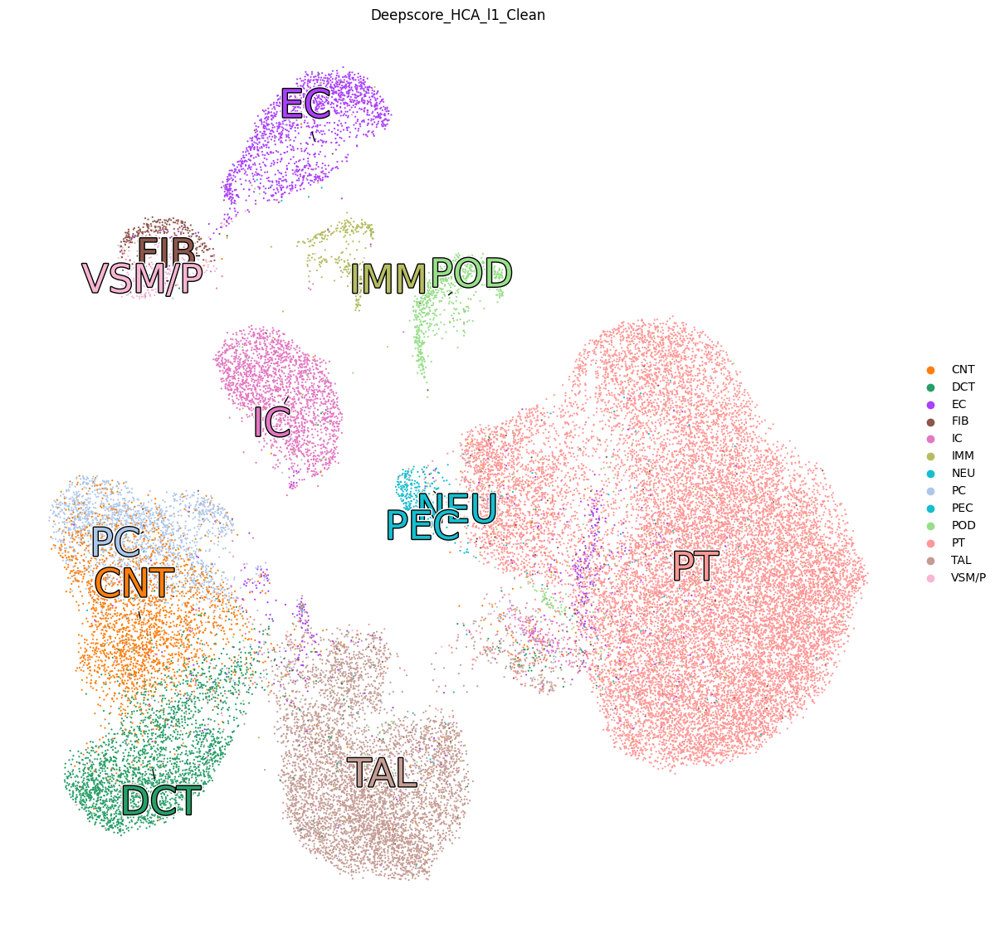

Figure size= (14, 14) dpi= 100.0 Scale factor = 45.4086088067726


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


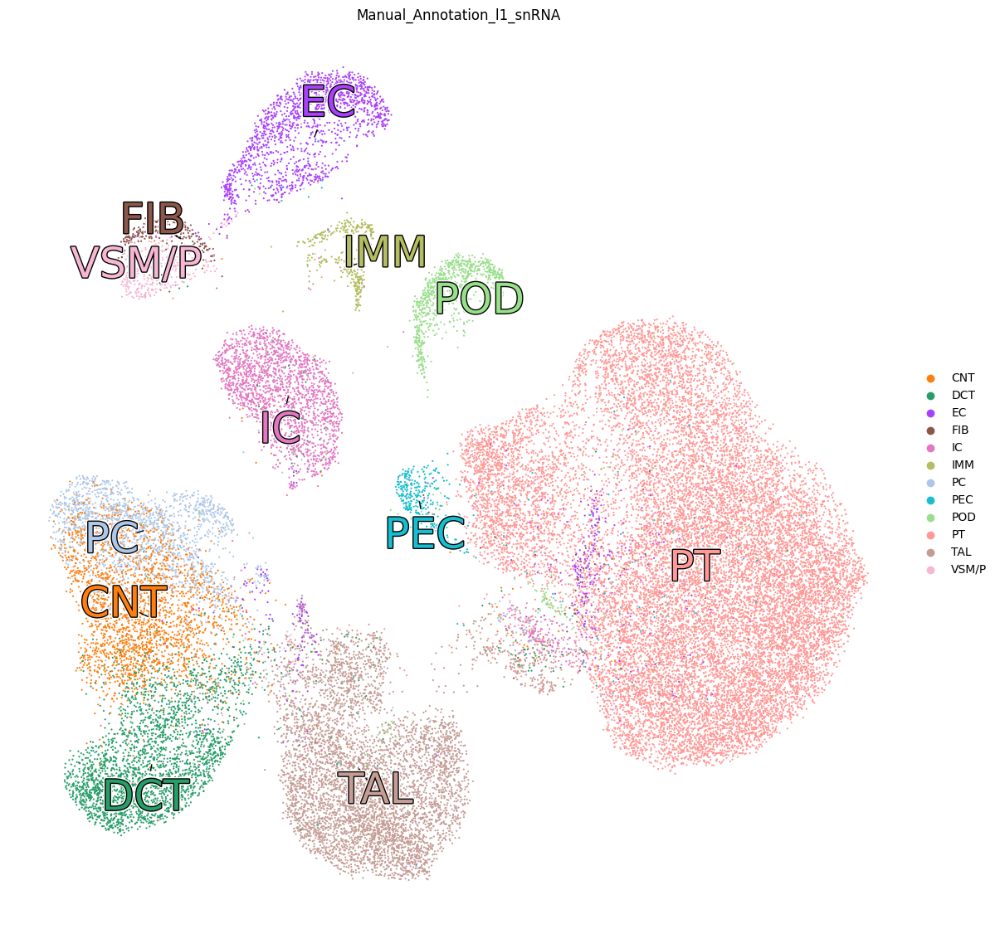

Figure size= (14, 14) dpi= 100.0 Scale factor = 45.4086088067726


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


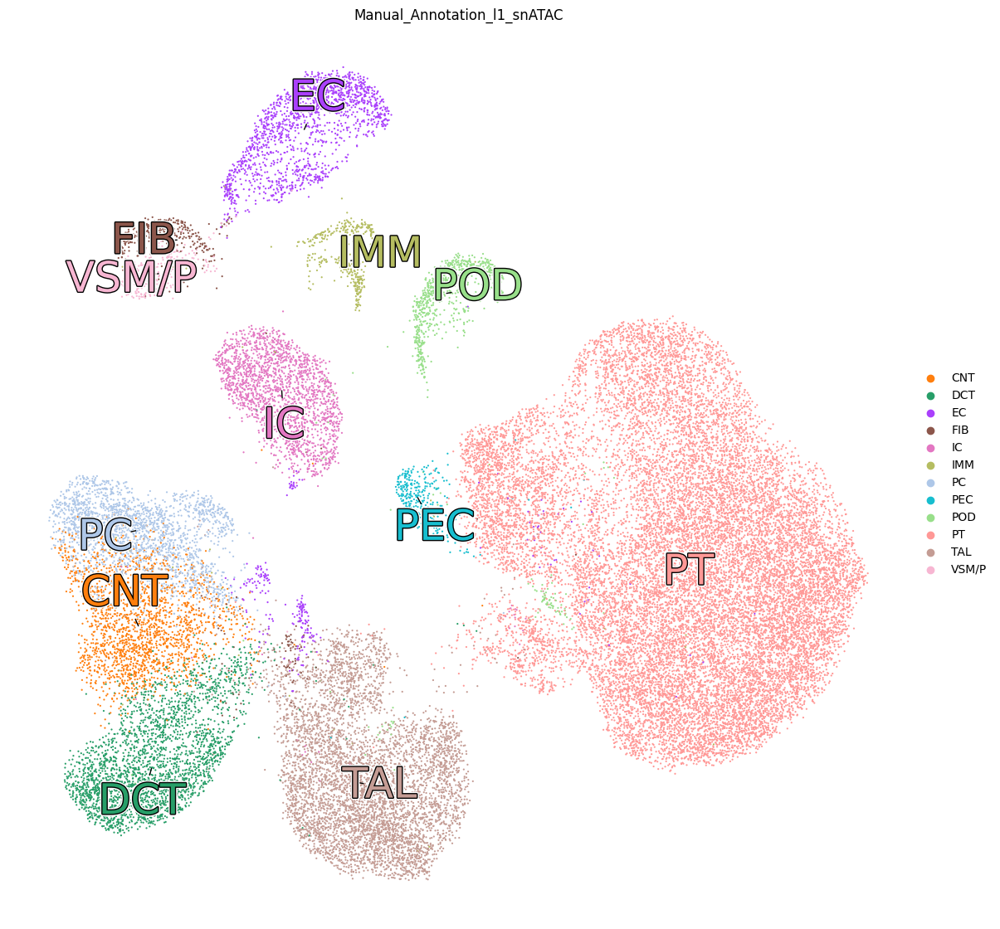

Figure size= (14, 14) dpi= 100.0 Scale factor = 48.62339021632429


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


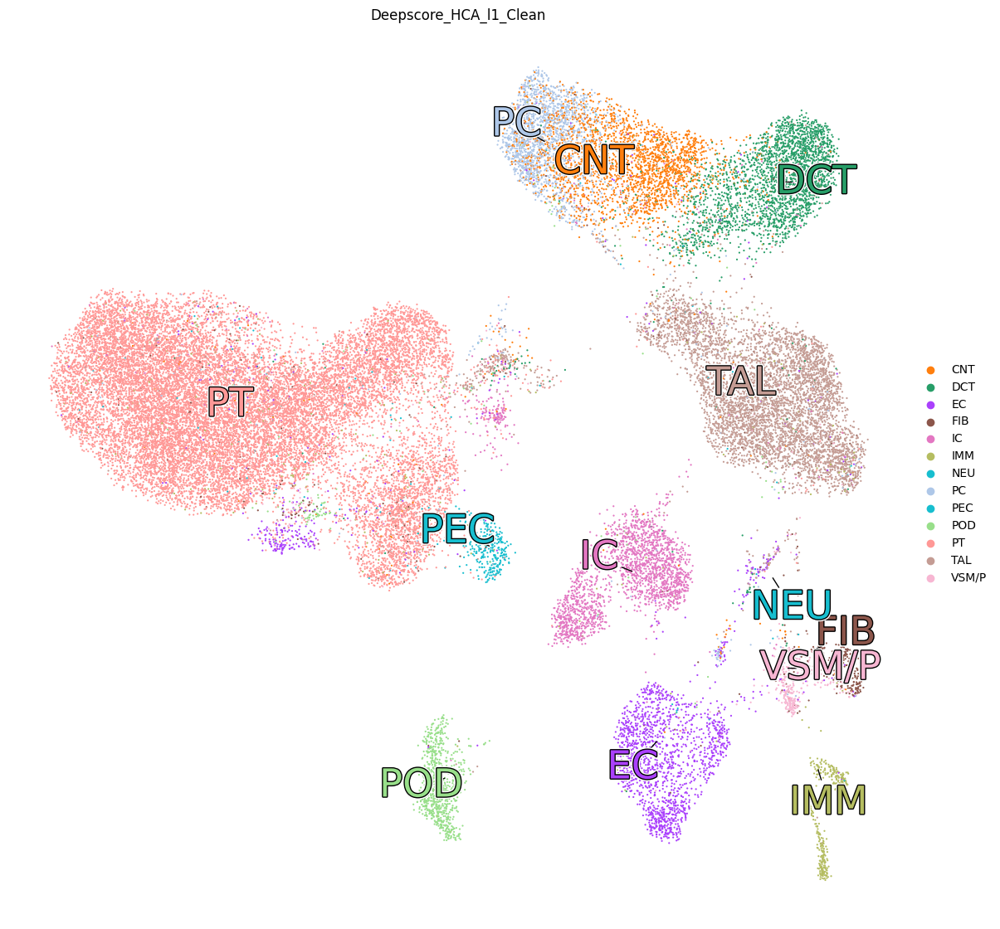

Figure size= (14, 14) dpi= 100.0 Scale factor = 48.62339021632429


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


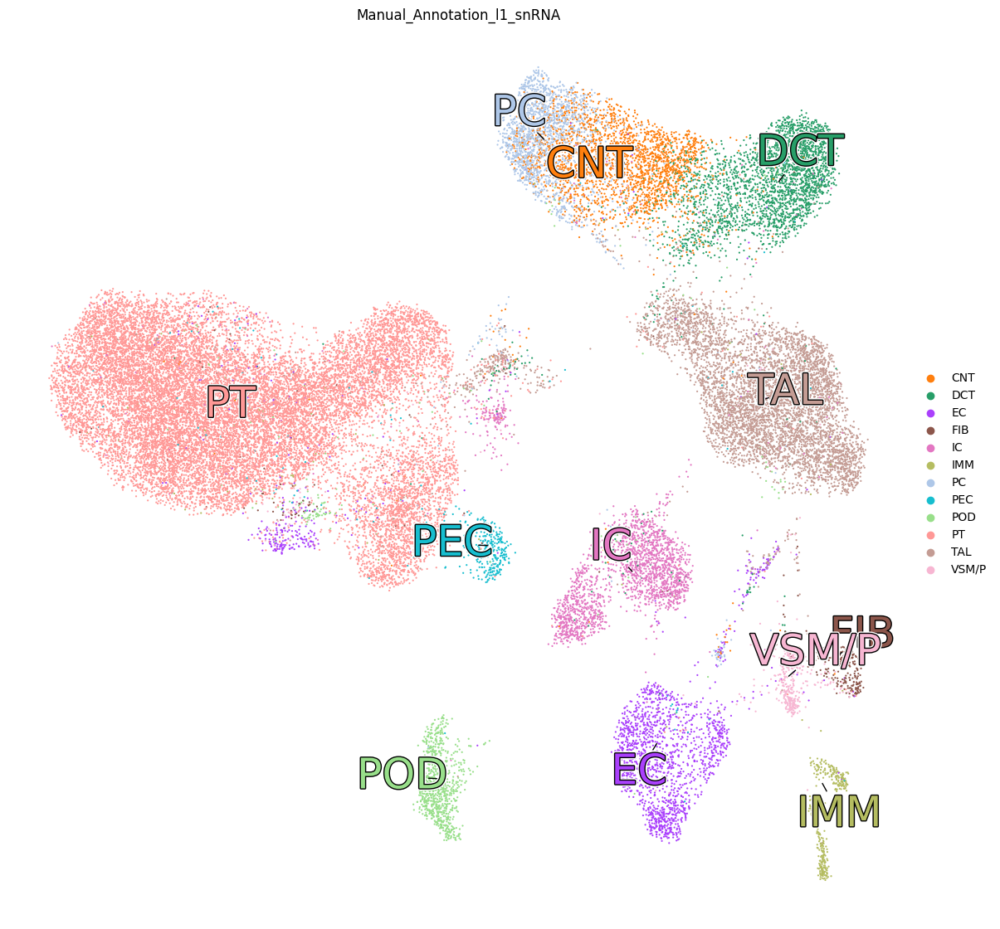

Figure size= (14, 14) dpi= 100.0 Scale factor = 48.62339021632429


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


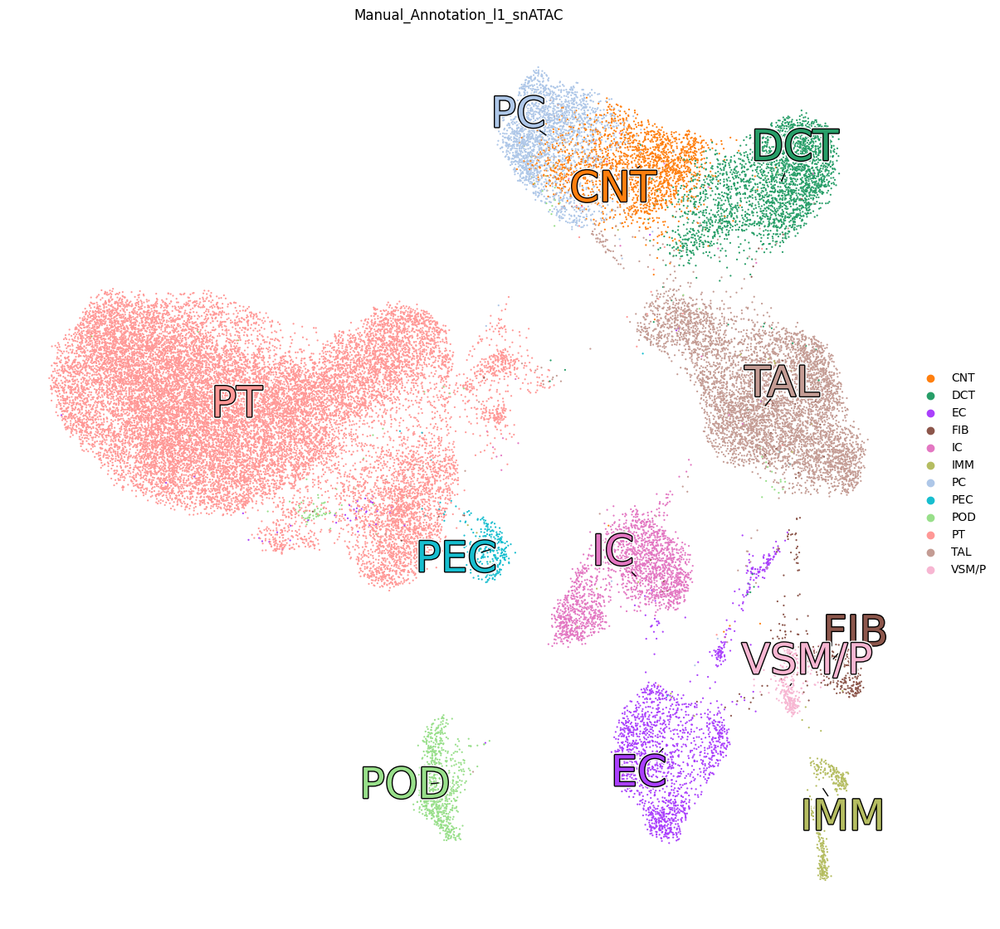

Figure size= (14, 14) dpi= 100.0 Scale factor = 45.652920211451715


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


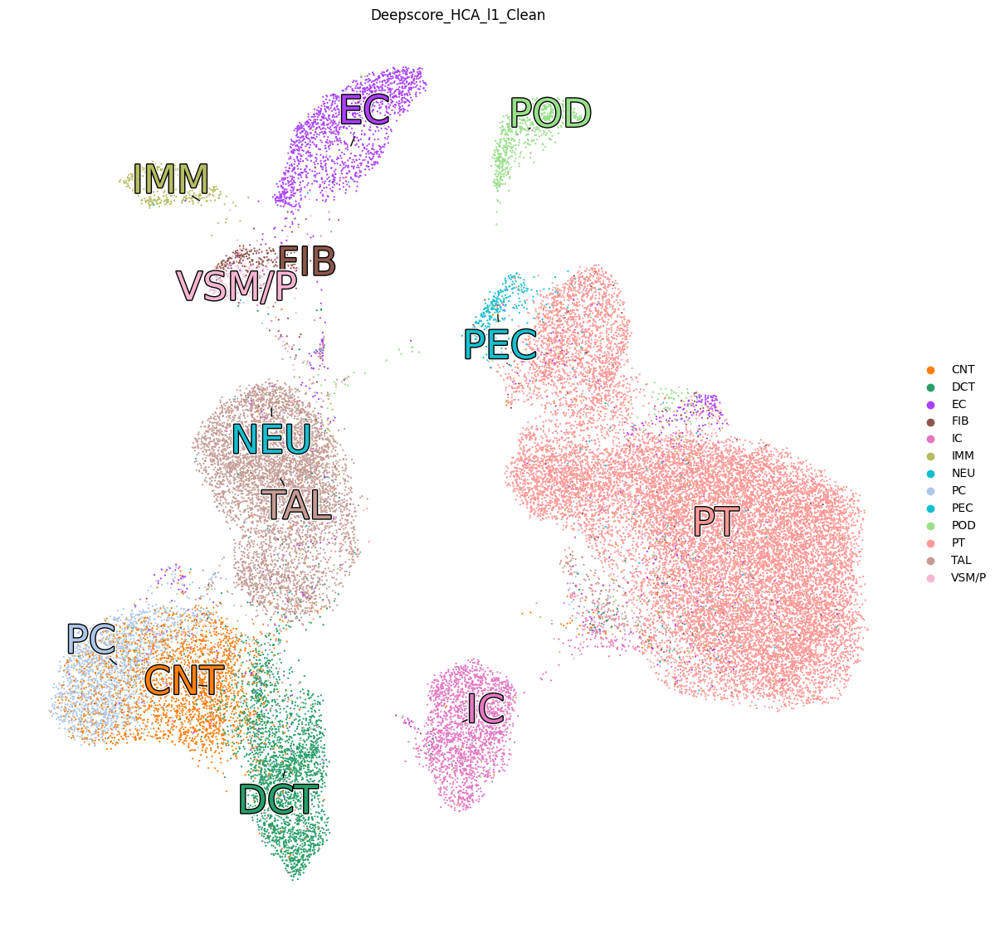

Figure size= (14, 14) dpi= 100.0 Scale factor = 45.652920211451715


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


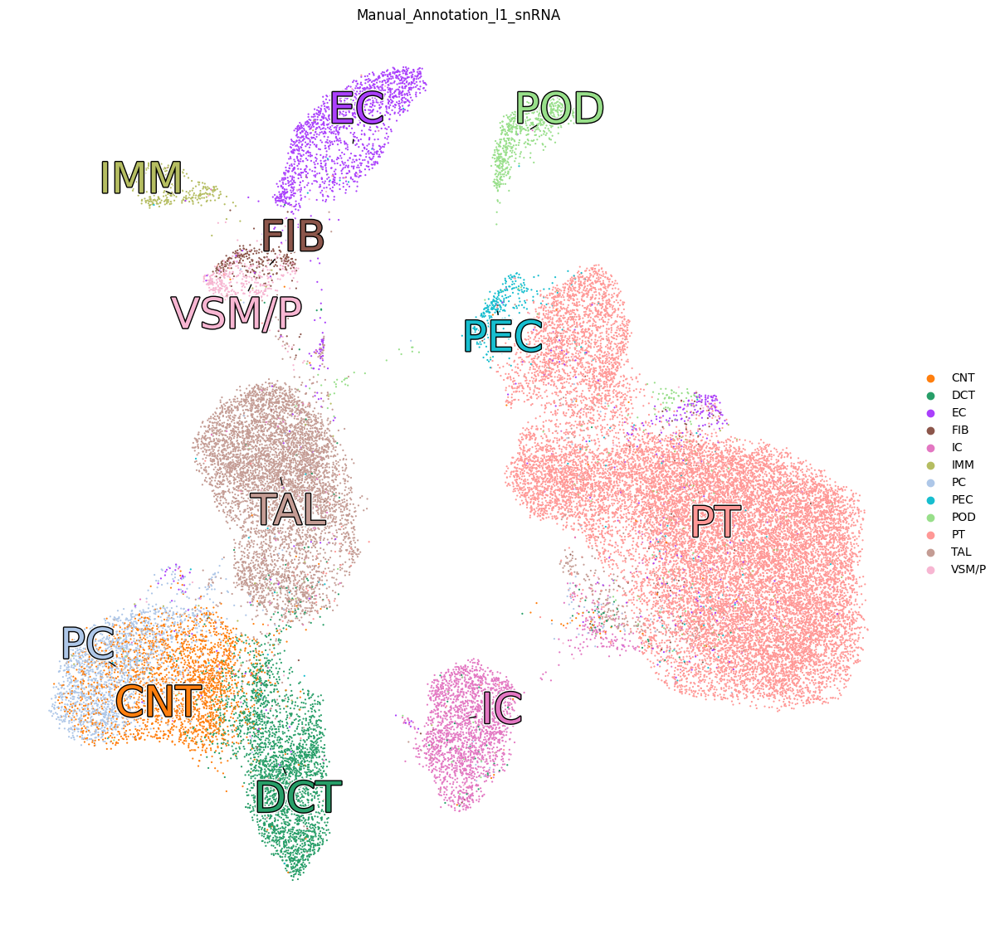

Figure size= (14, 14) dpi= 100.0 Scale factor = 45.652920211451715


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


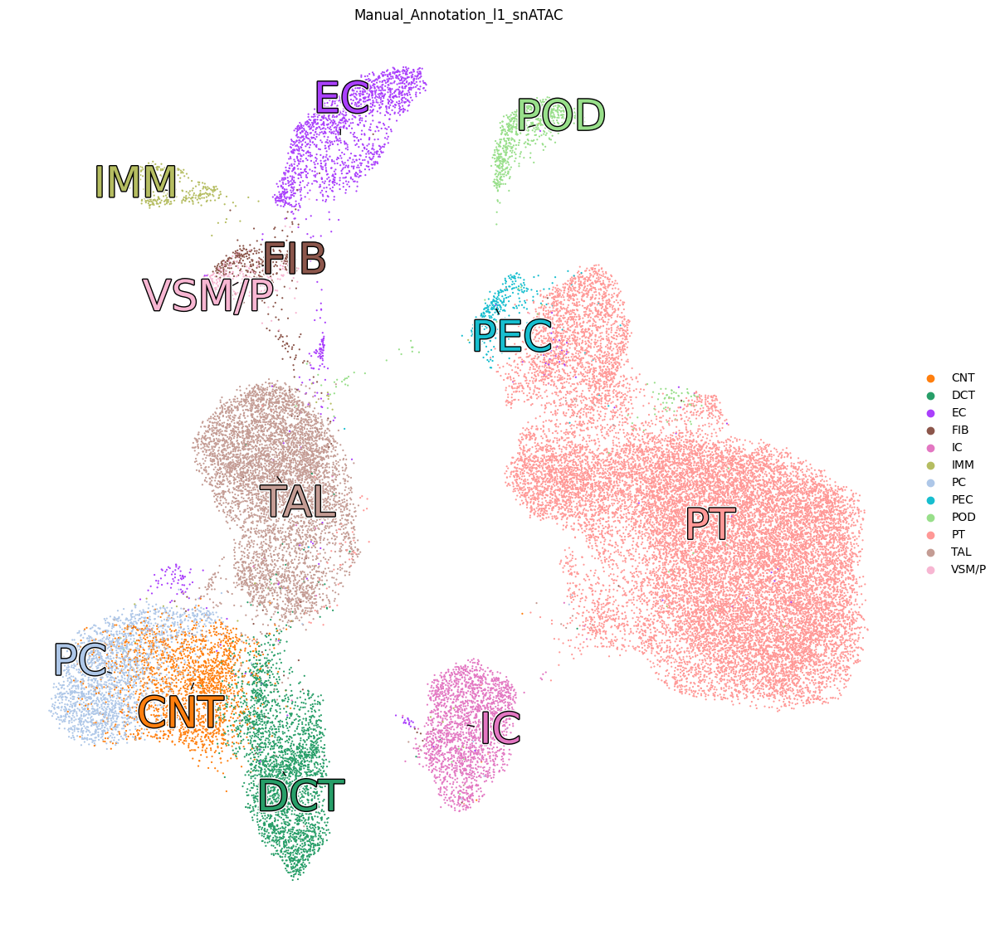

Figure size= (14, 14) dpi= 100.0 Scale factor = 41.56630086310575


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


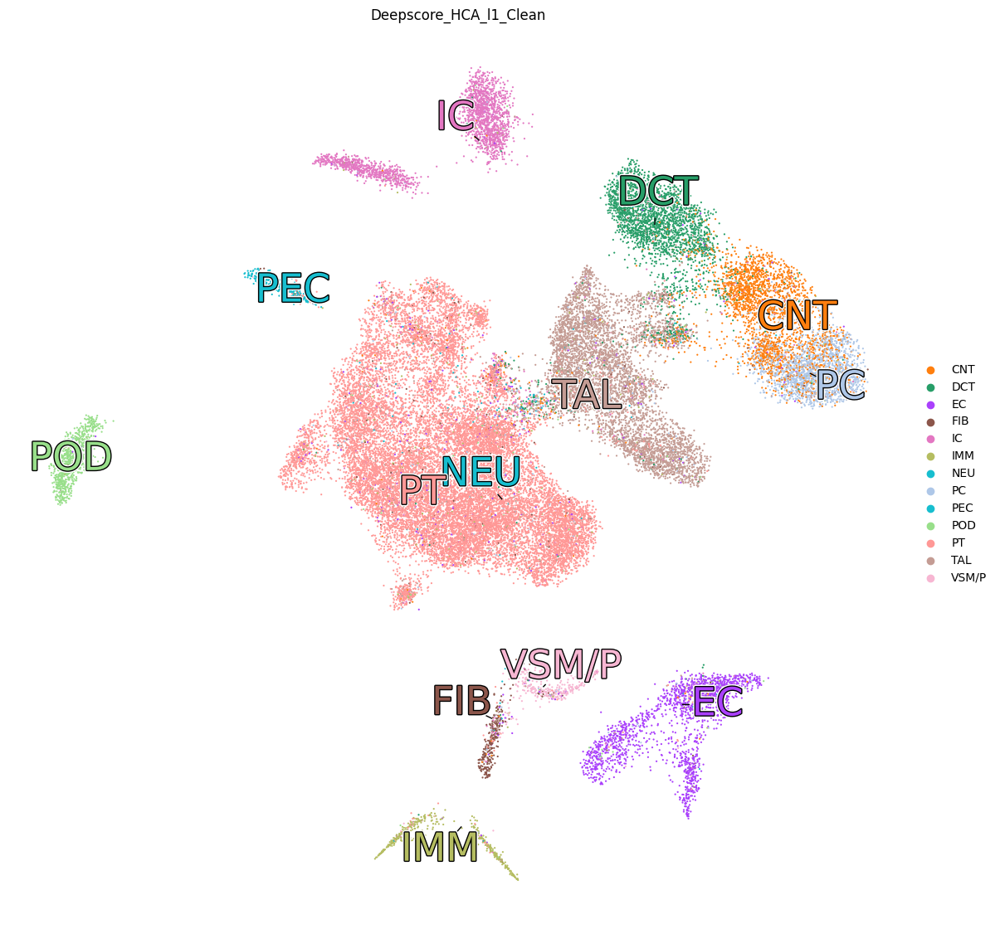

Figure size= (14, 14) dpi= 100.0 Scale factor = 41.56630086310575


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


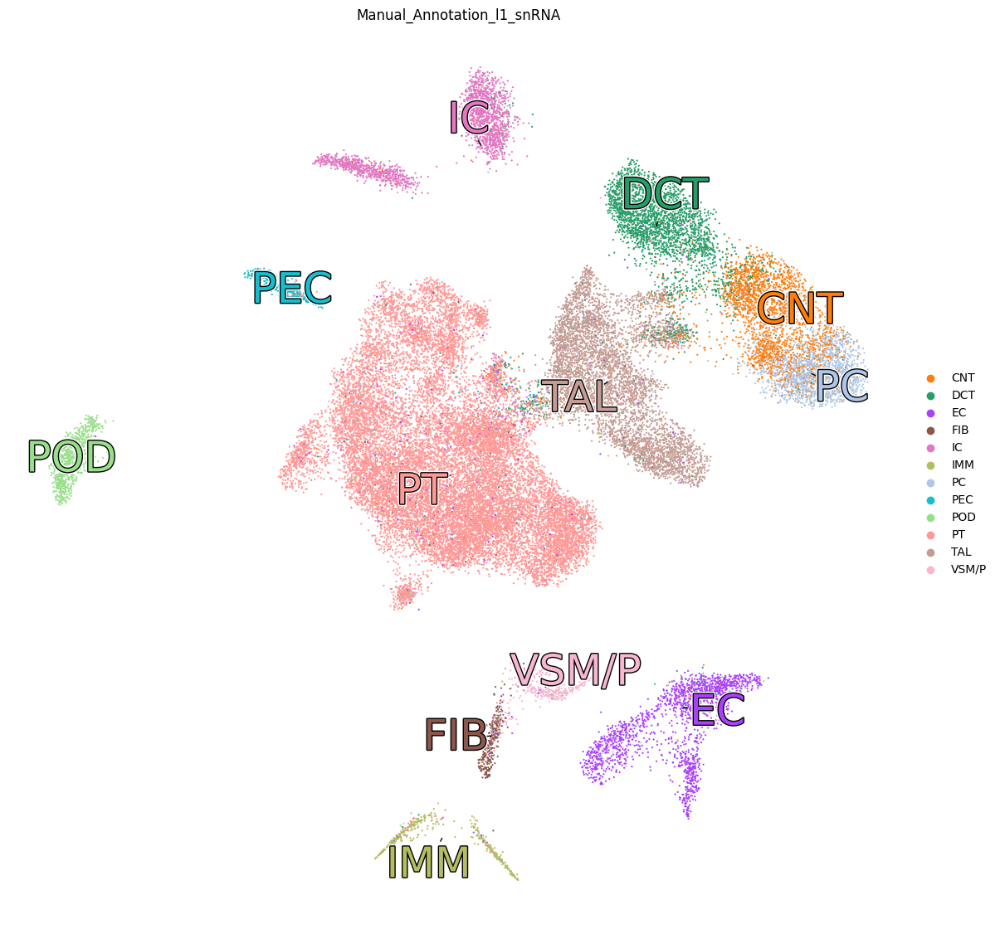

Figure size= (14, 14) dpi= 100.0 Scale factor = 41.56630086310575


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


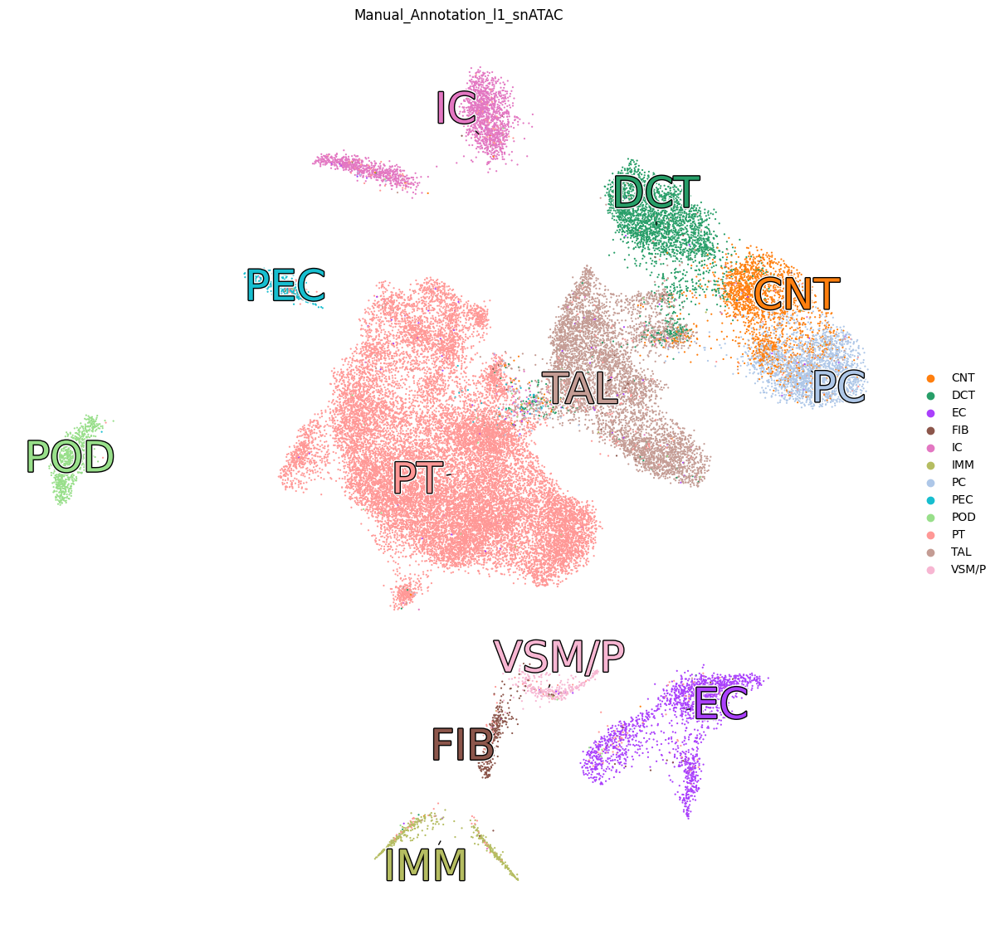

Figure size= (14, 14) dpi= 100.0 Scale factor = 44.981436429028804


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


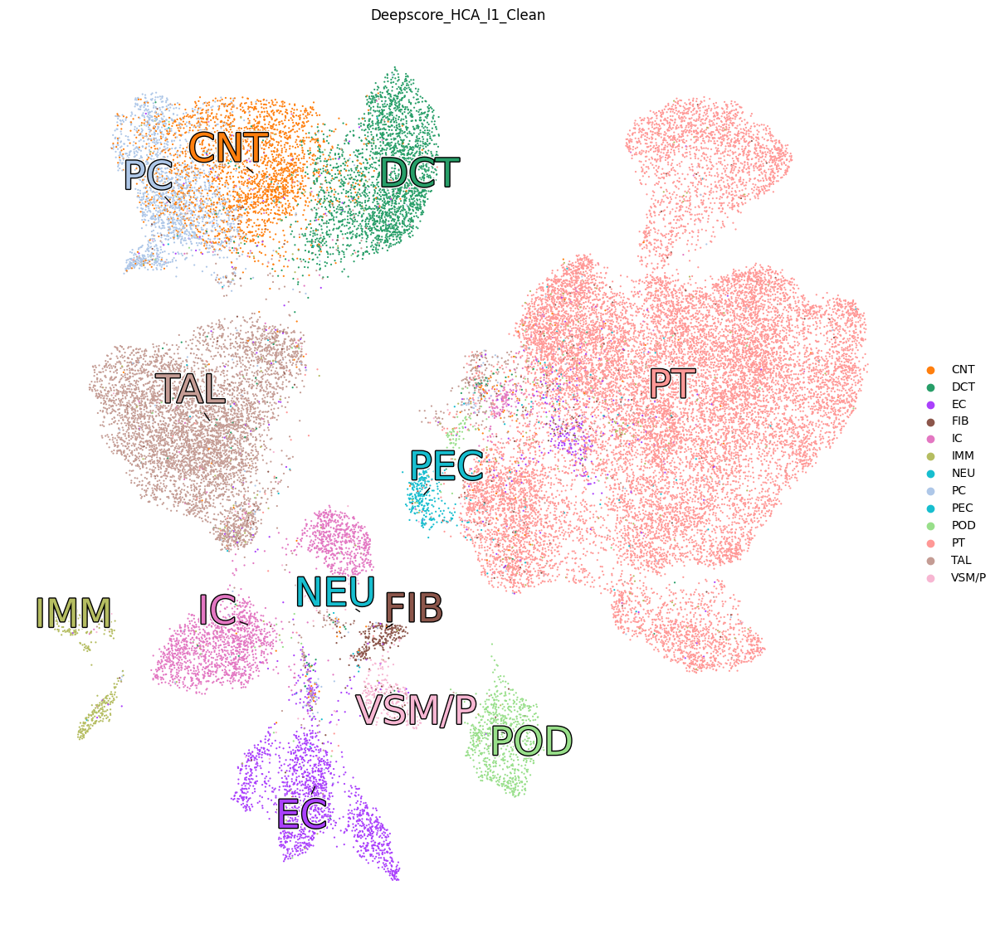

Figure size= (14, 14) dpi= 100.0 Scale factor = 44.981436429028804


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


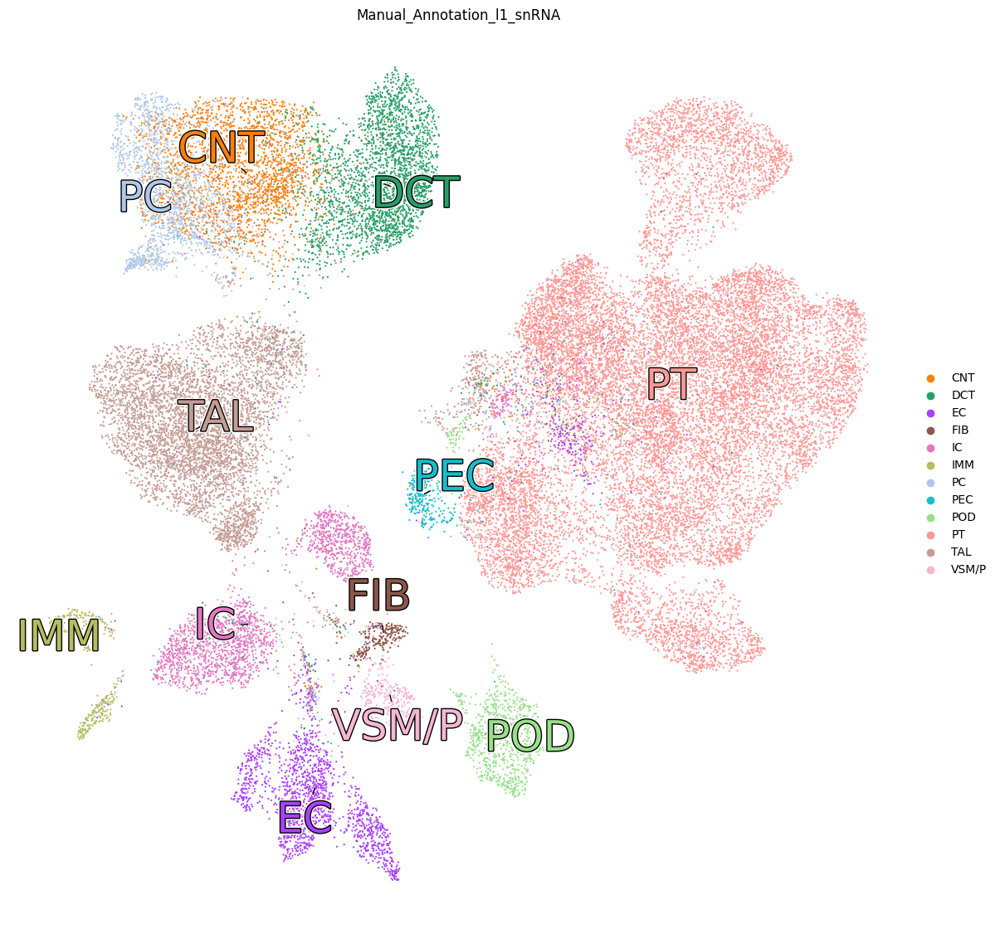

Figure size= (14, 14) dpi= 100.0 Scale factor = 44.981436429028804


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


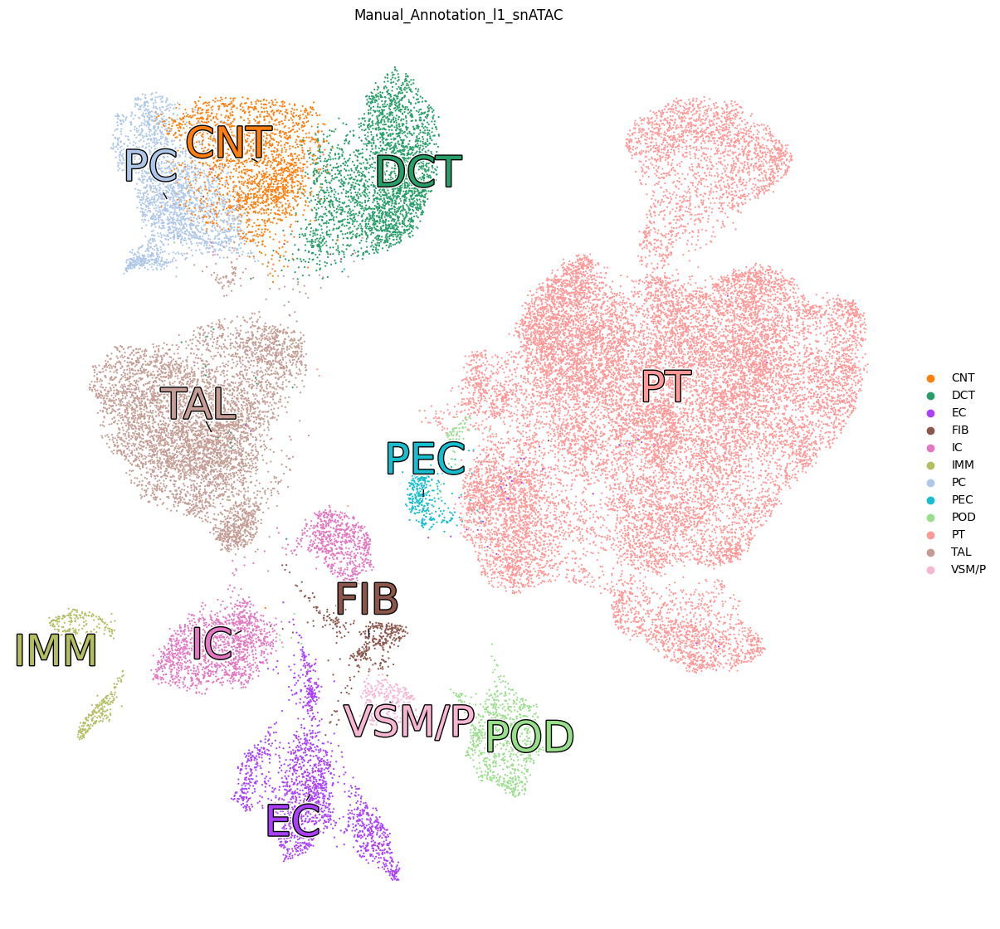

Figure size= (14, 14) dpi= 100.0 Scale factor = 44.900535653714385


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


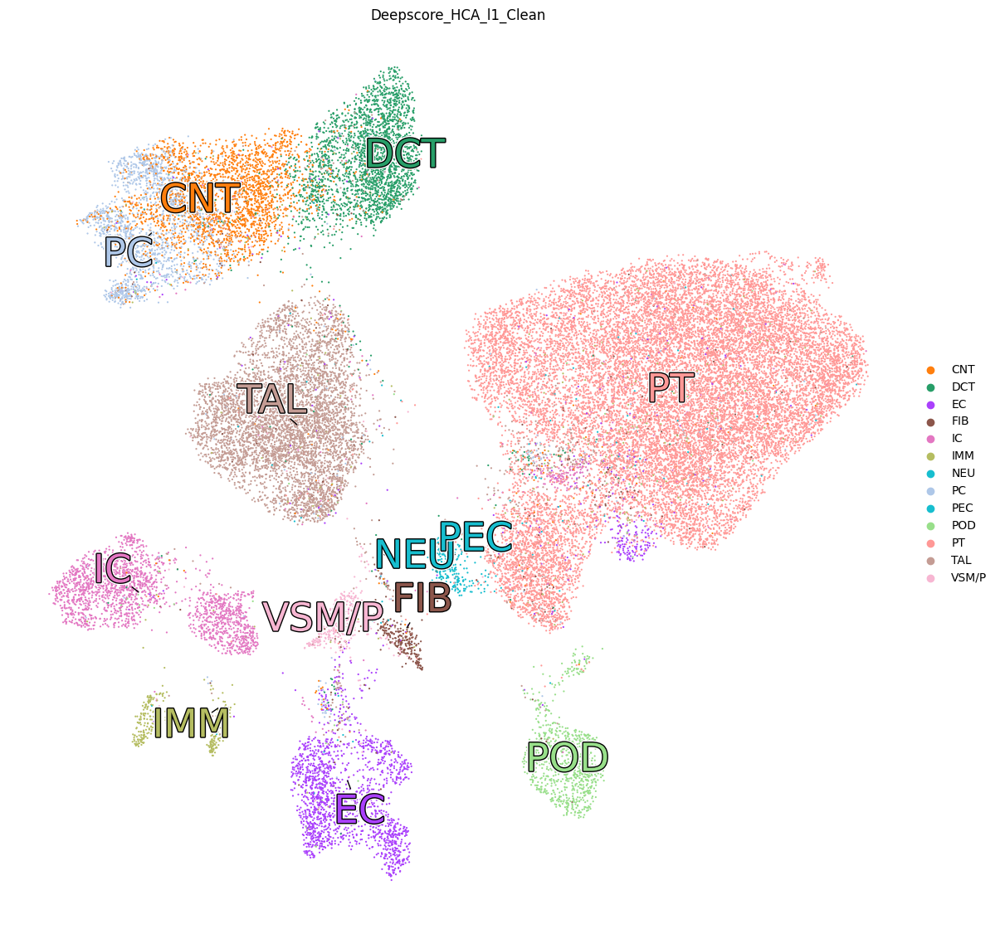

Figure size= (14, 14) dpi= 100.0 Scale factor = 44.900535653714385


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


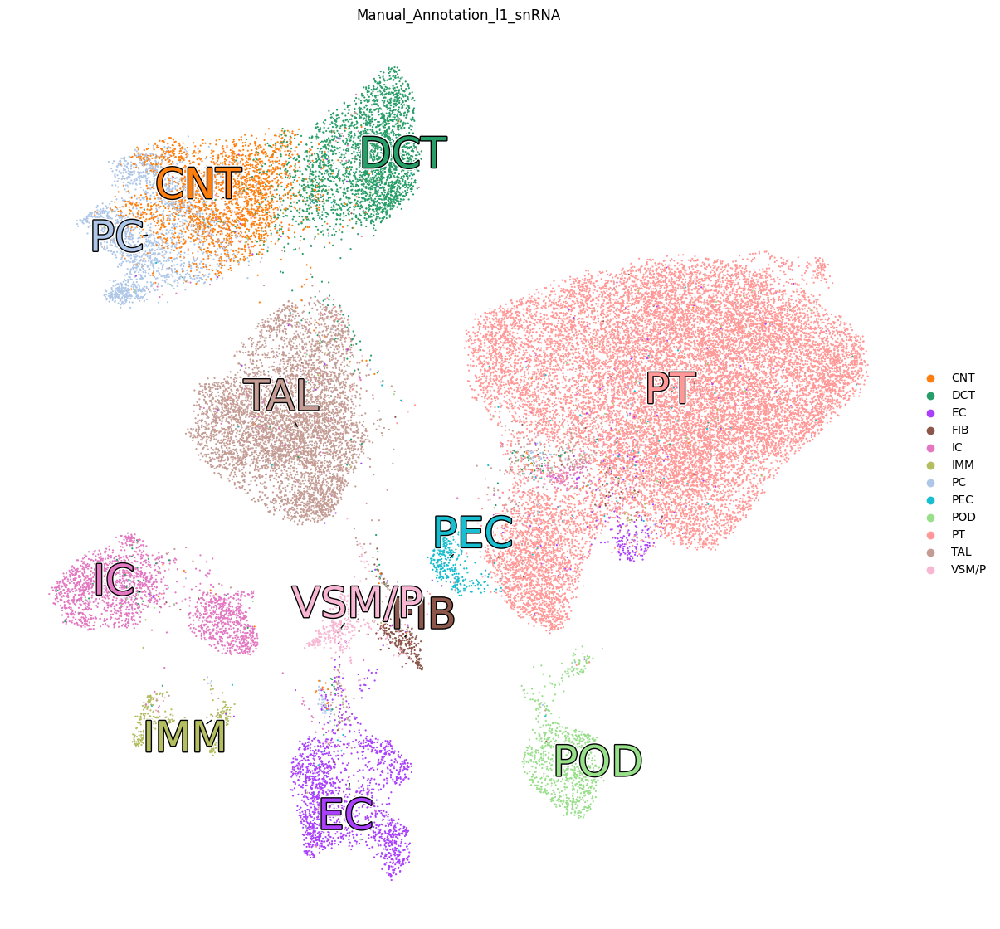

Figure size= (14, 14) dpi= 100.0 Scale factor = 44.900535653714385


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


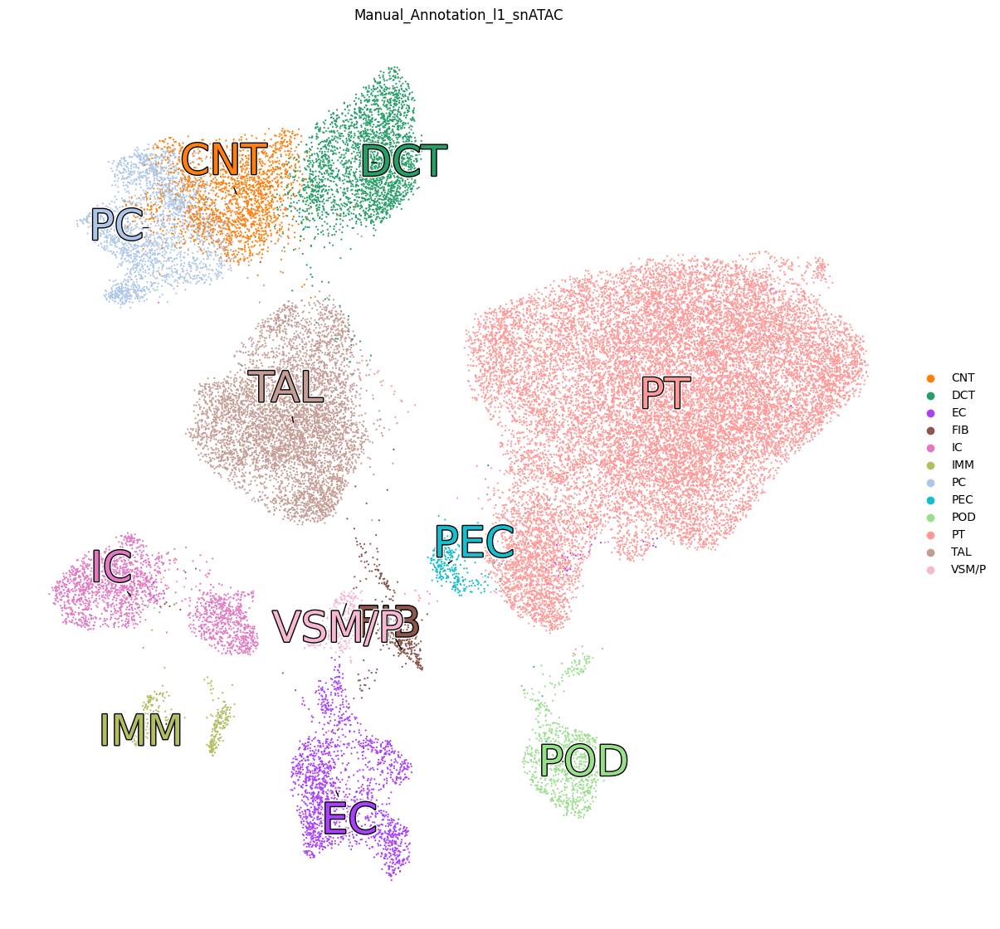

Figure size= (14, 14) dpi= 100.0 Scale factor = 45.82119542545403


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


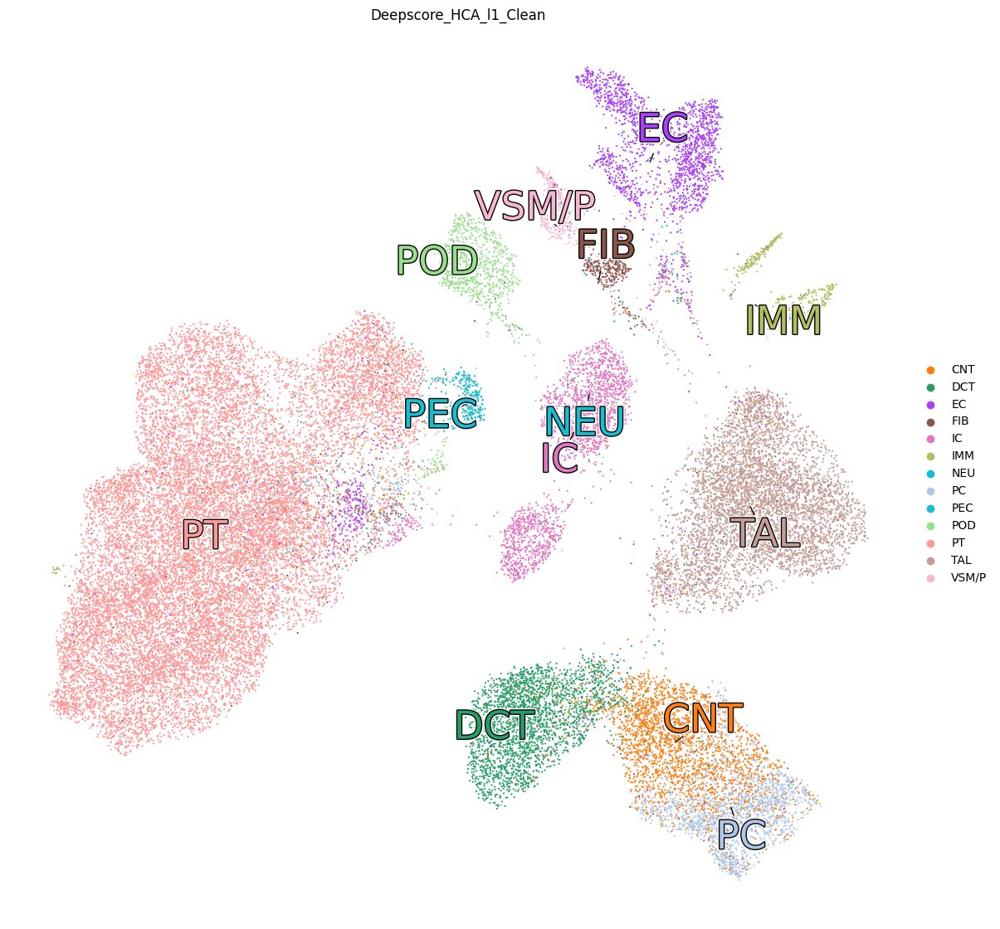

Figure size= (14, 14) dpi= 100.0 Scale factor = 45.82119542545403


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


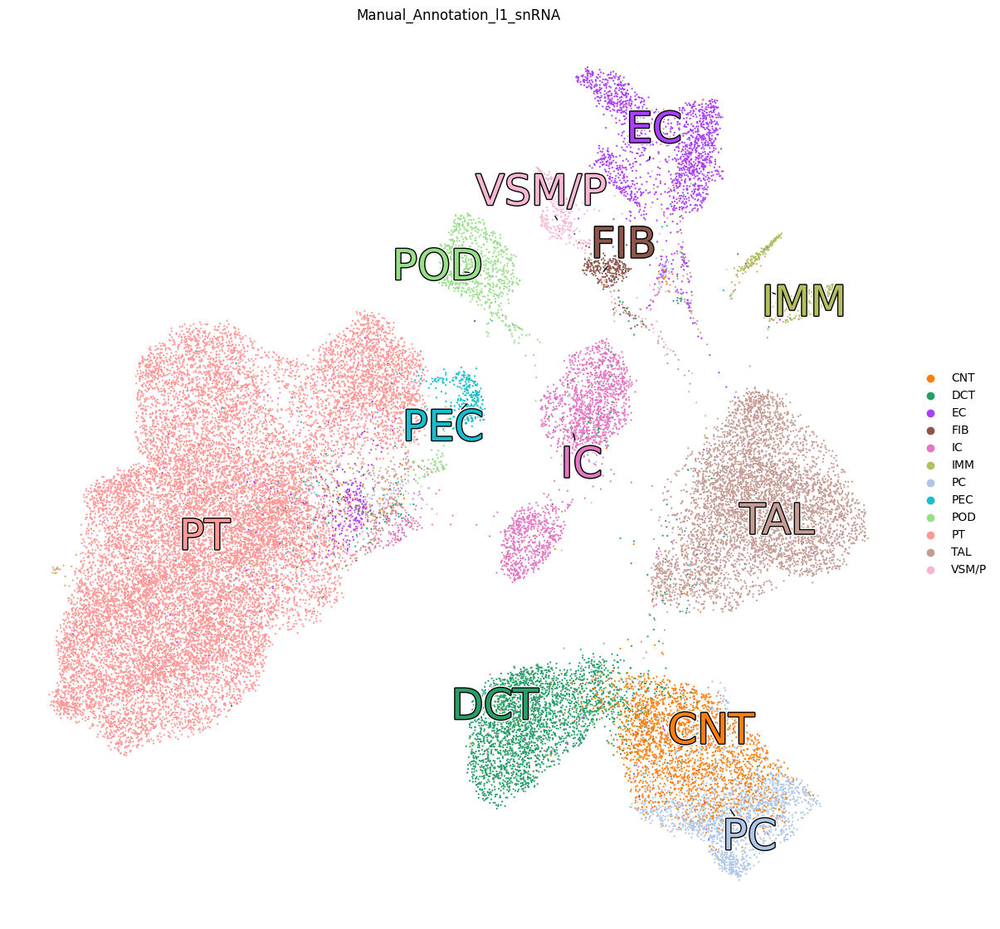

Figure size= (14, 14) dpi= 100.0 Scale factor = 45.82119542545403


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


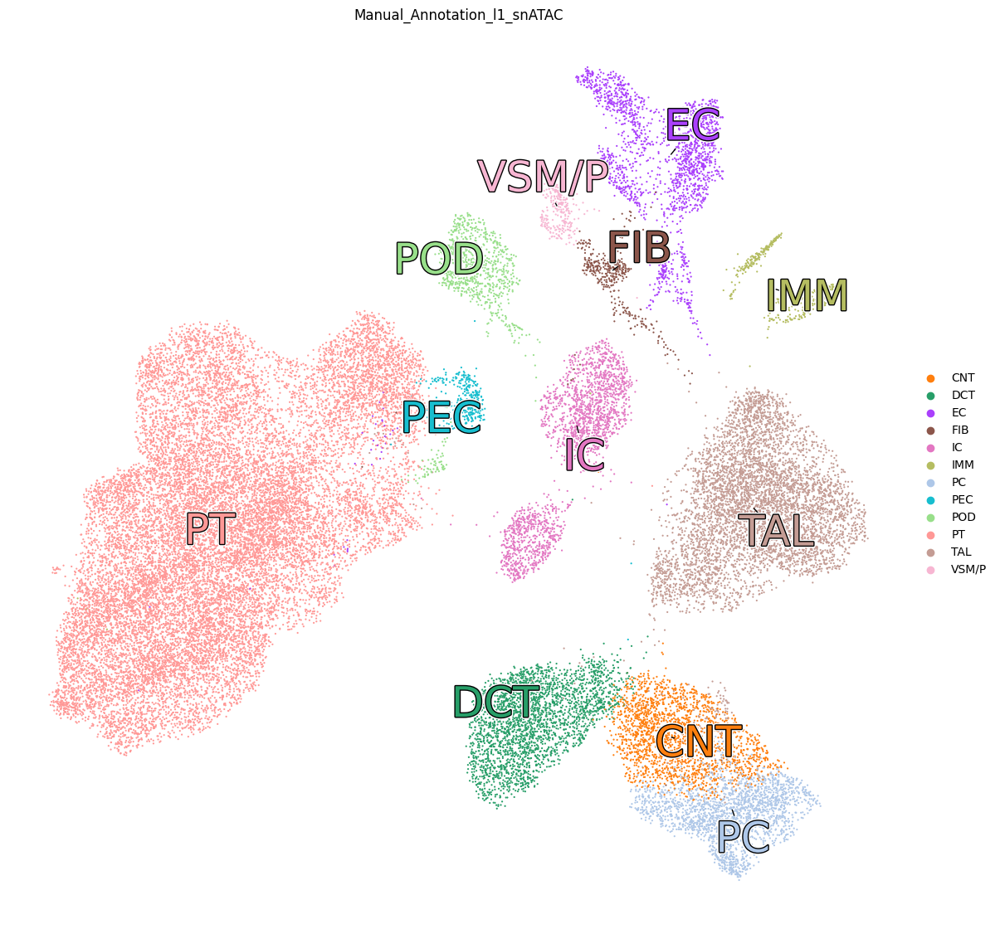

In [14]:
for latent in ['PeakVI','PoissonVI','PoissonVI_fragments','ATAC_LSI_Seurat_WNN','Spectral','Spectral_Harmony','Spectral_mnn']:
    for ann in ['Deepscore_HCA_l1_Clean','Manual_Annotation_l1_snRNA','Manual_Annotation_l1_snATAC']:
        adata.uns[f'{ann}_colors'] = [l1_colors[i] for i in adata.obs[ann].cat.categories]
        umap_refined(adata,
                    umap = f'Umap_{latent}',
                    var = ann,
                    size= 10,
                    label_size = 35 * (50/len(adata.obs[ann].unique())),
                    width_in_inches = 14,
                    height_in_inches = 14,
                    max_iterations=7)
        plt.savefig(f'figures/UMAP_{ann}_{latent}.png',  bbox_inches='tight', dpi=300)
        plt.show()

Figure size= (14, 14) dpi= 100.0 Scale factor = 45.4086088067726


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


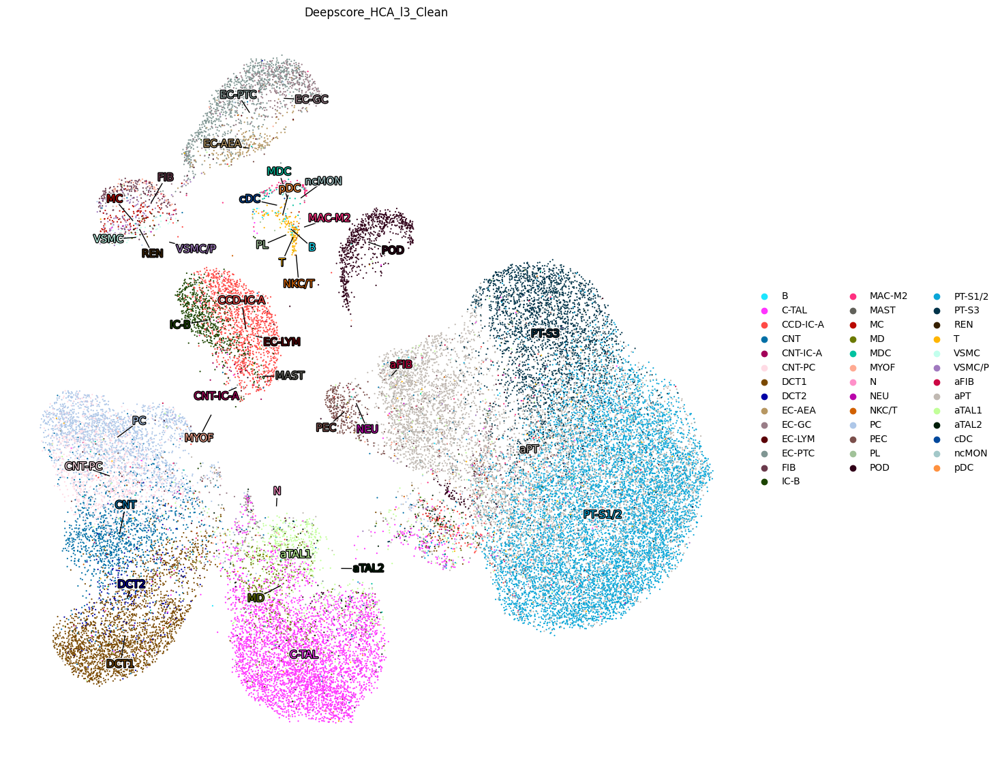

Figure size= (14, 14) dpi= 100.0 Scale factor = 45.4086088067726


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


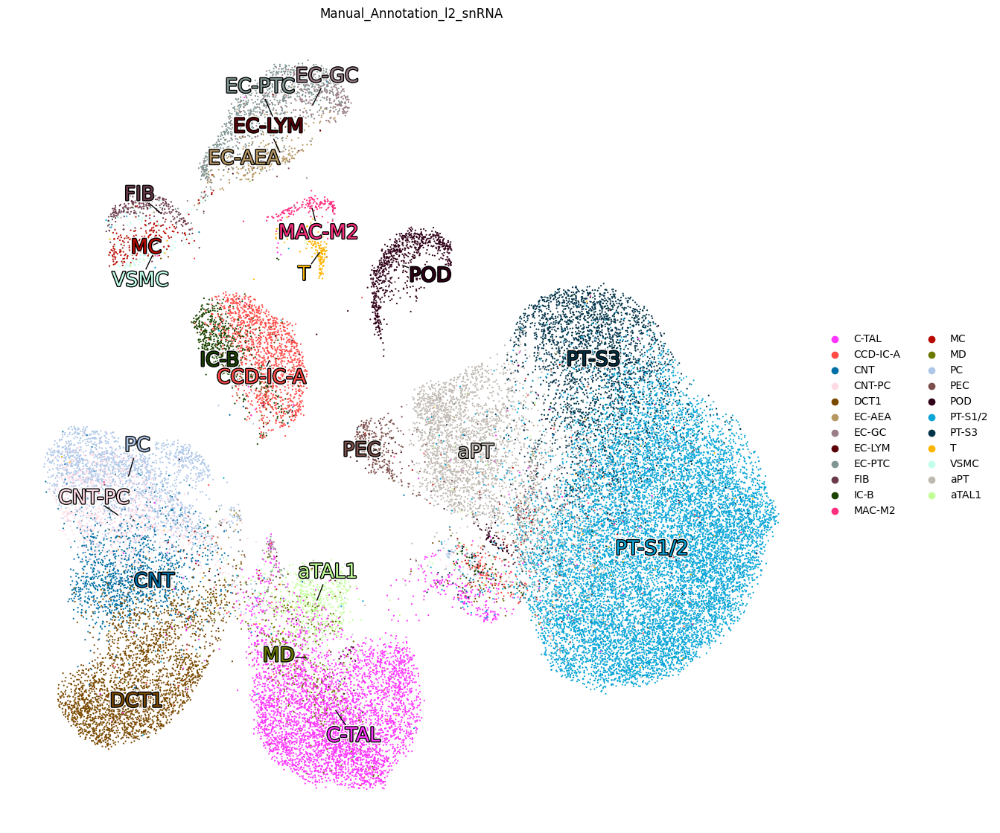

Figure size= (14, 14) dpi= 100.0 Scale factor = 45.4086088067726


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


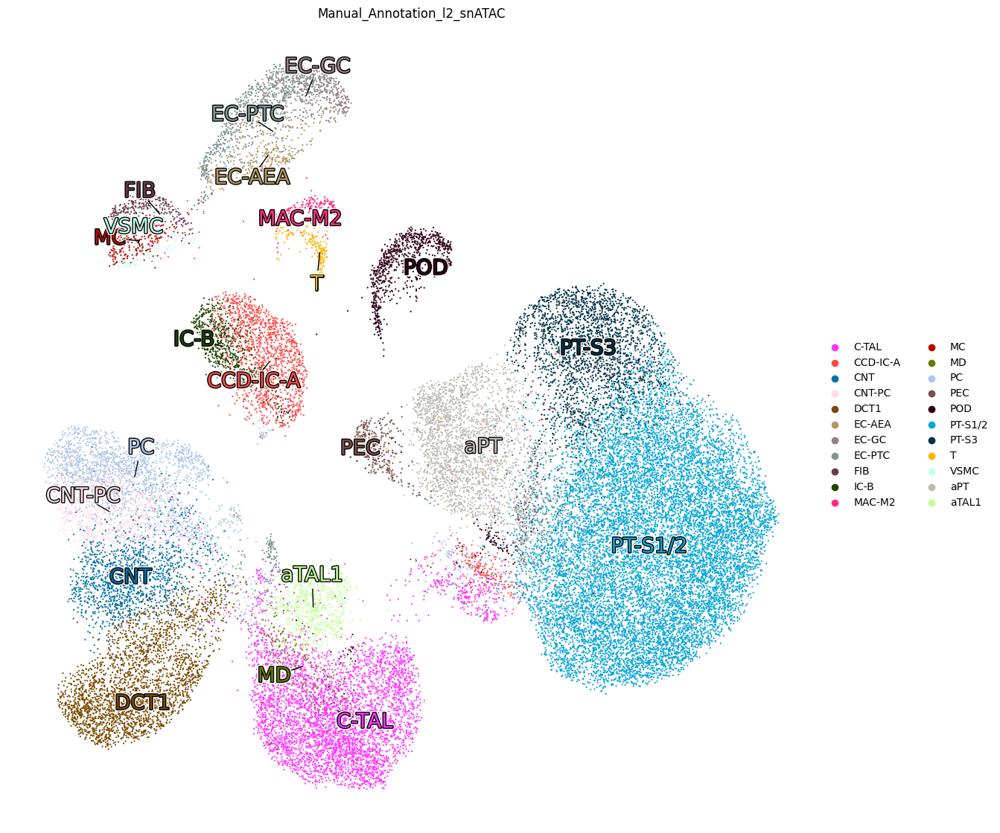

Figure size= (14, 14) dpi= 100.0 Scale factor = 48.62339021632429


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


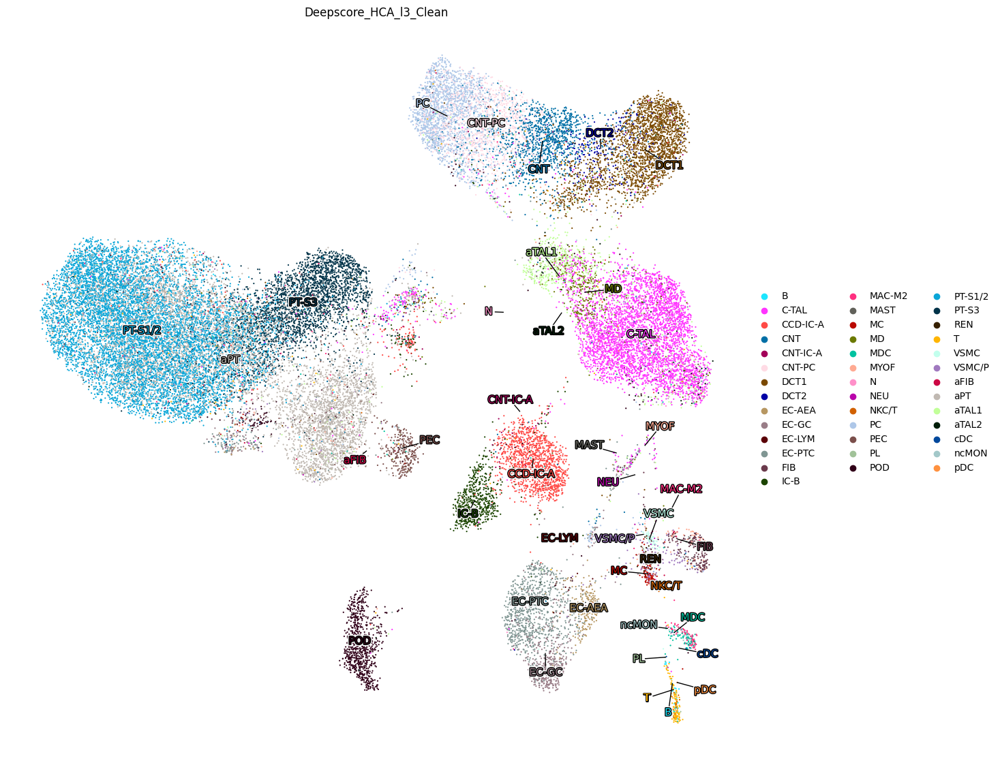

Figure size= (14, 14) dpi= 100.0 Scale factor = 48.62339021632429


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


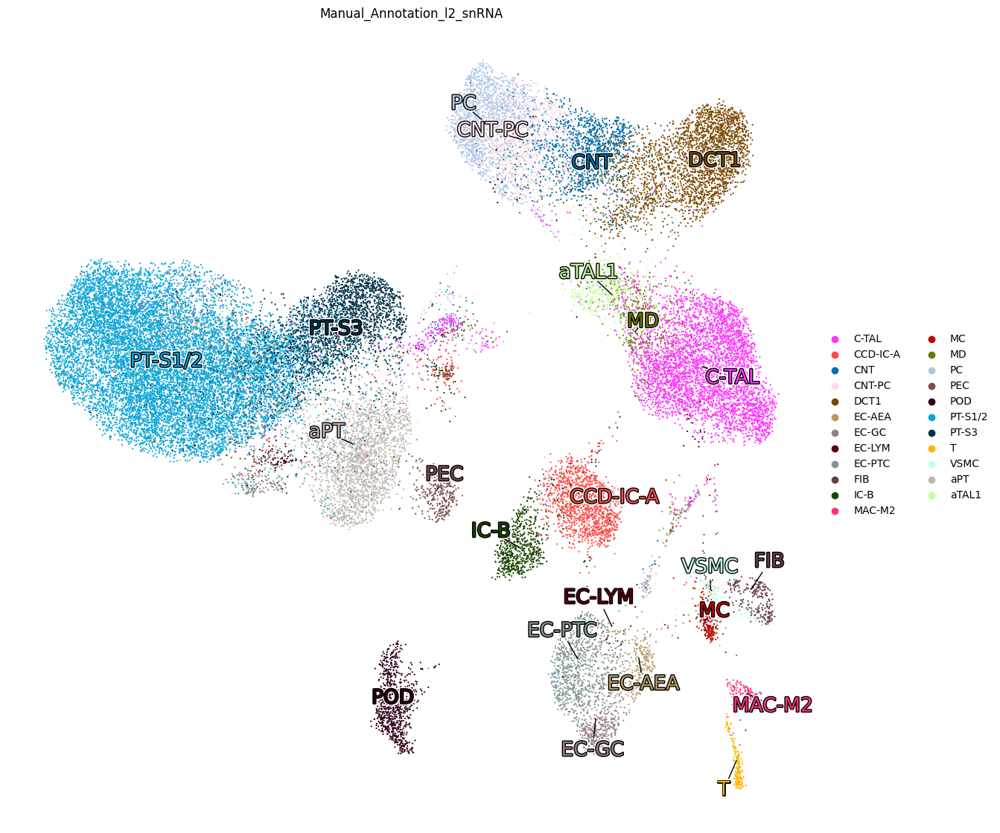

Figure size= (14, 14) dpi= 100.0 Scale factor = 48.62339021632429


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


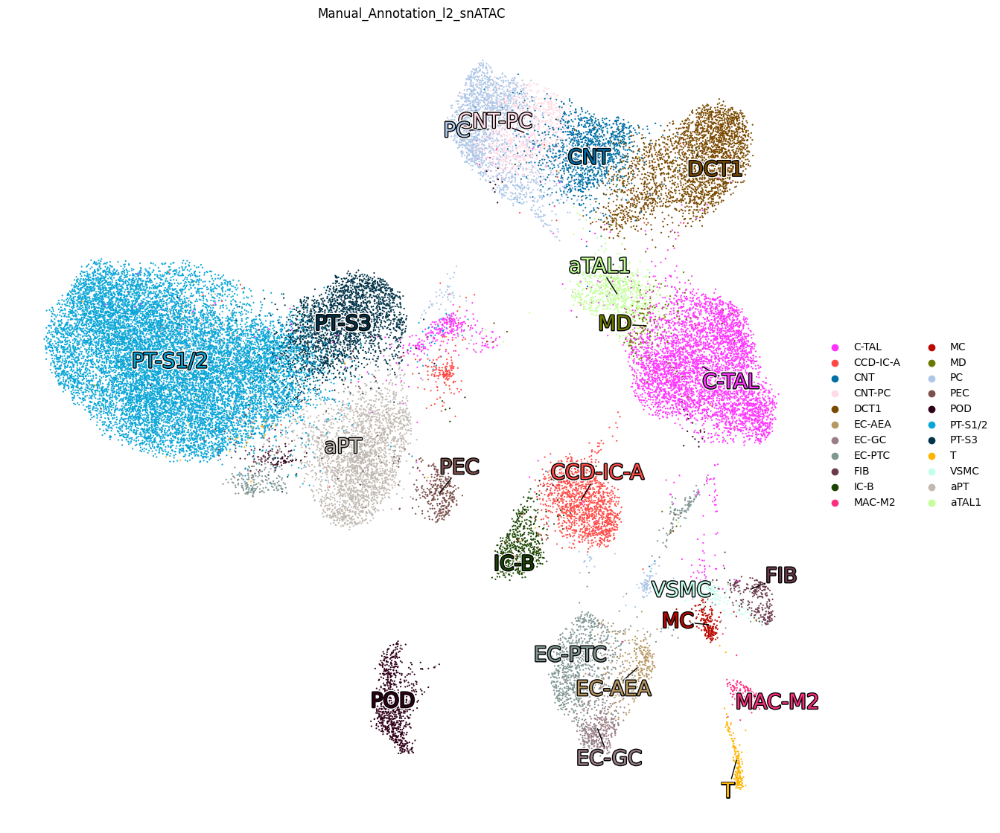

Figure size= (14, 14) dpi= 100.0 Scale factor = 45.652920211451715


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


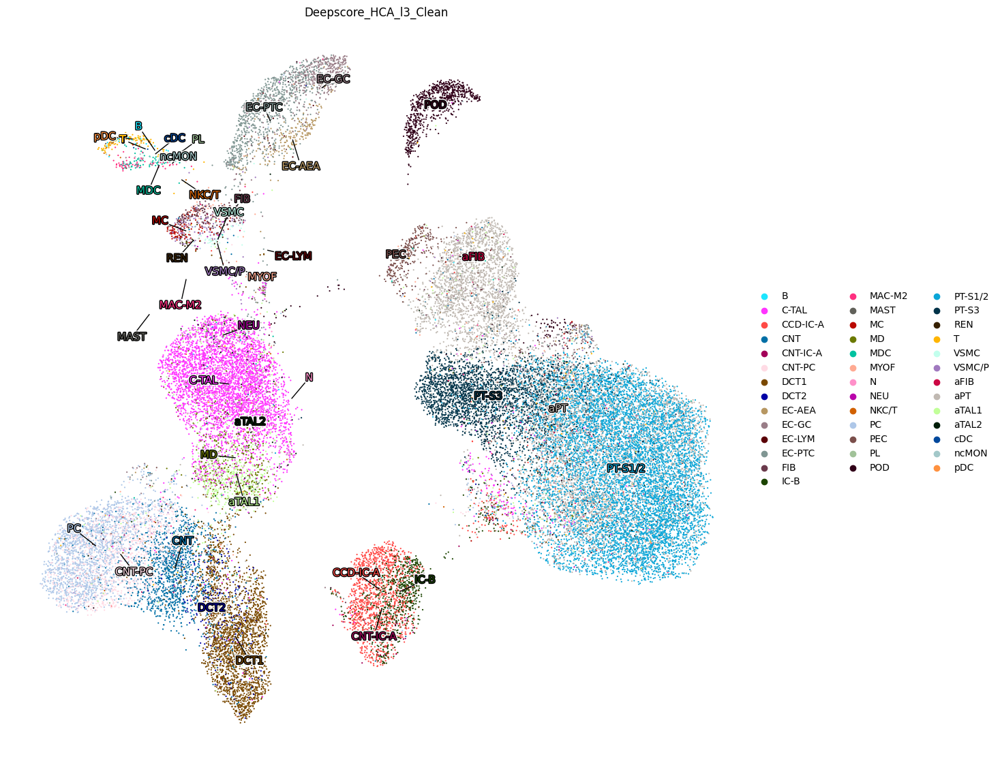

Figure size= (14, 14) dpi= 100.0 Scale factor = 45.652920211451715


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


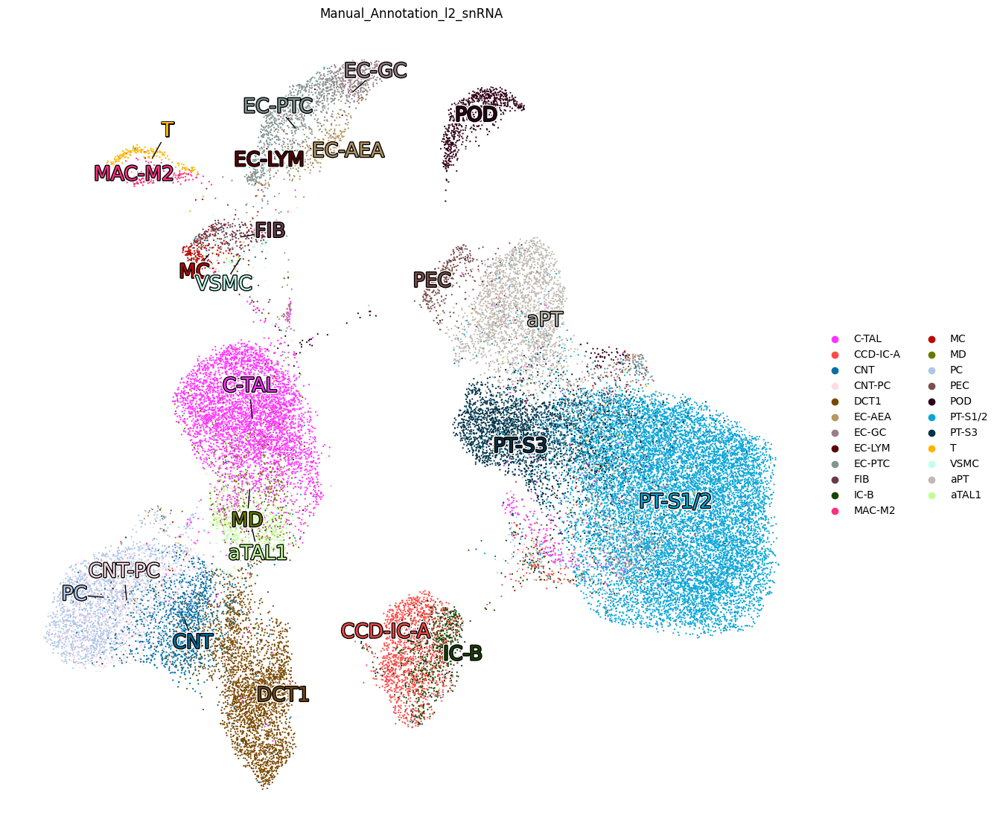

Figure size= (14, 14) dpi= 100.0 Scale factor = 45.652920211451715


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


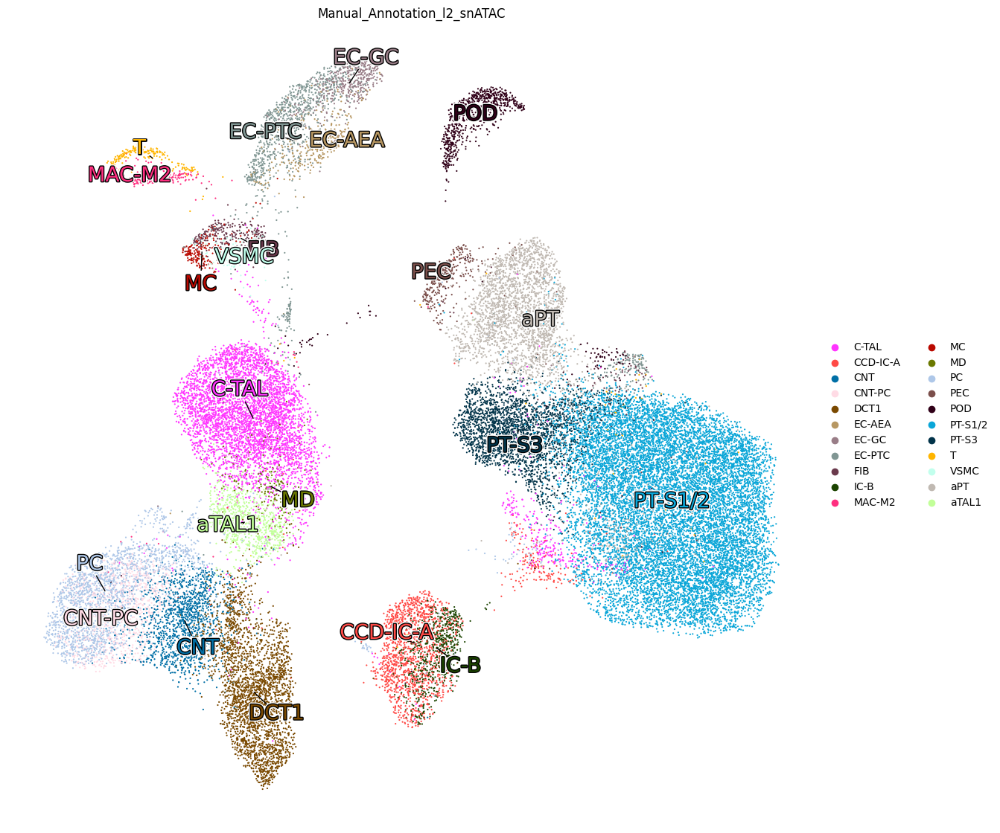

Figure size= (14, 14) dpi= 100.0 Scale factor = 41.56630086310575


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


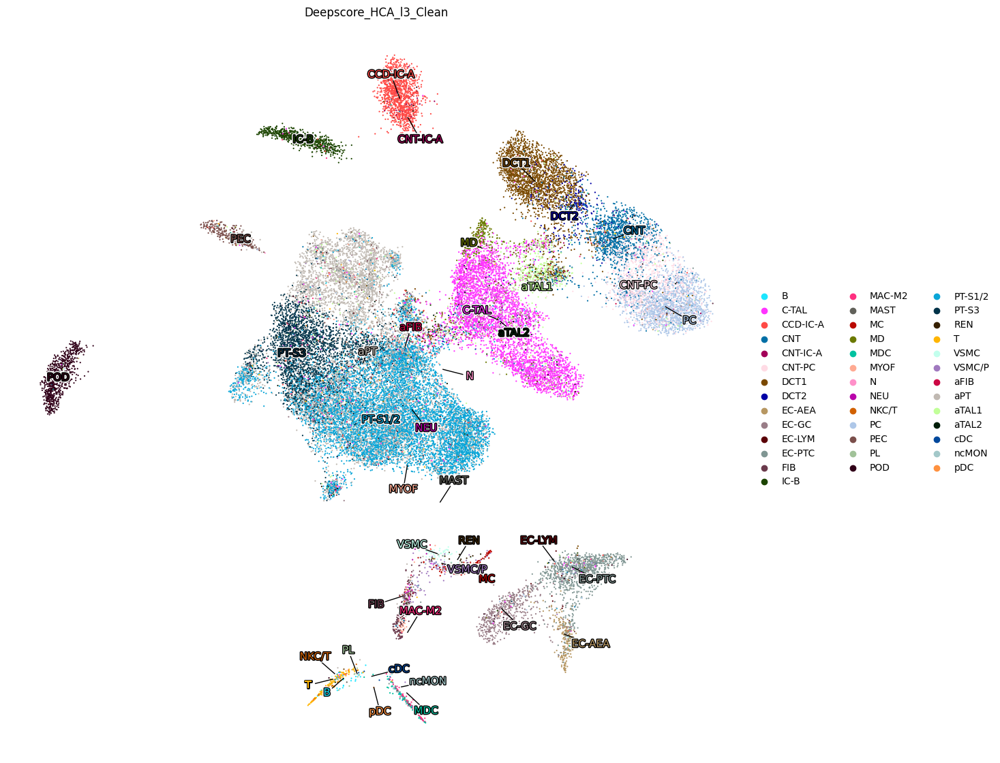

Figure size= (14, 14) dpi= 100.0 Scale factor = 41.56630086310575


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


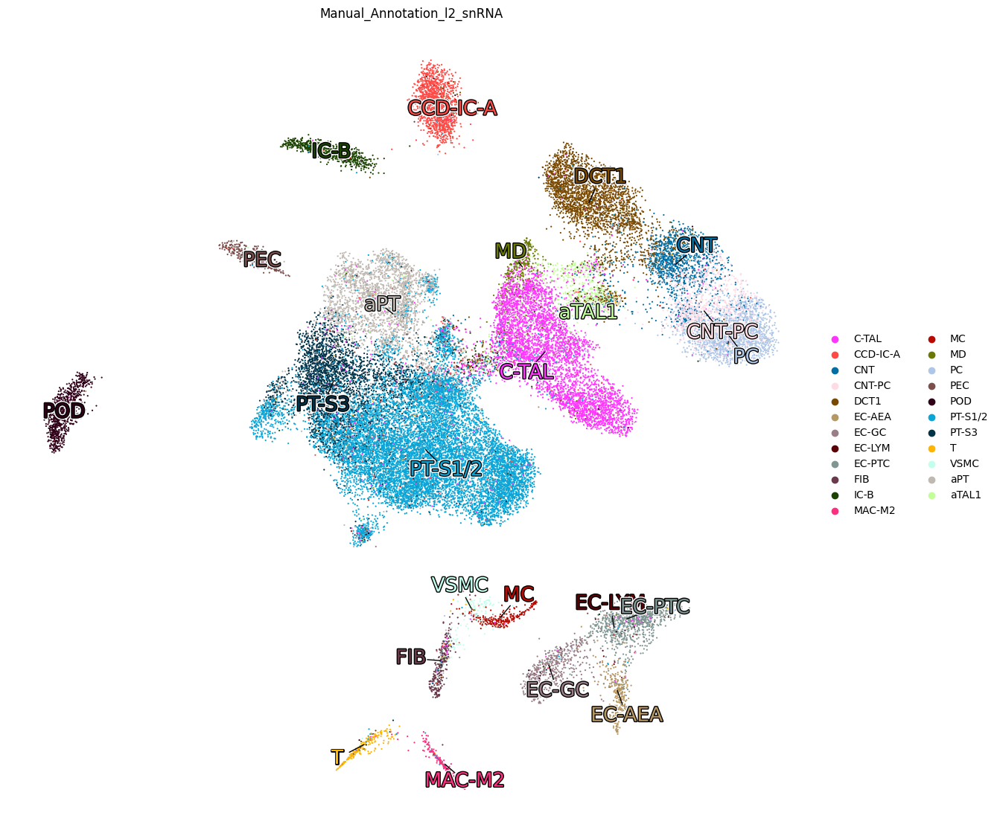

Figure size= (14, 14) dpi= 100.0 Scale factor = 41.56630086310575


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


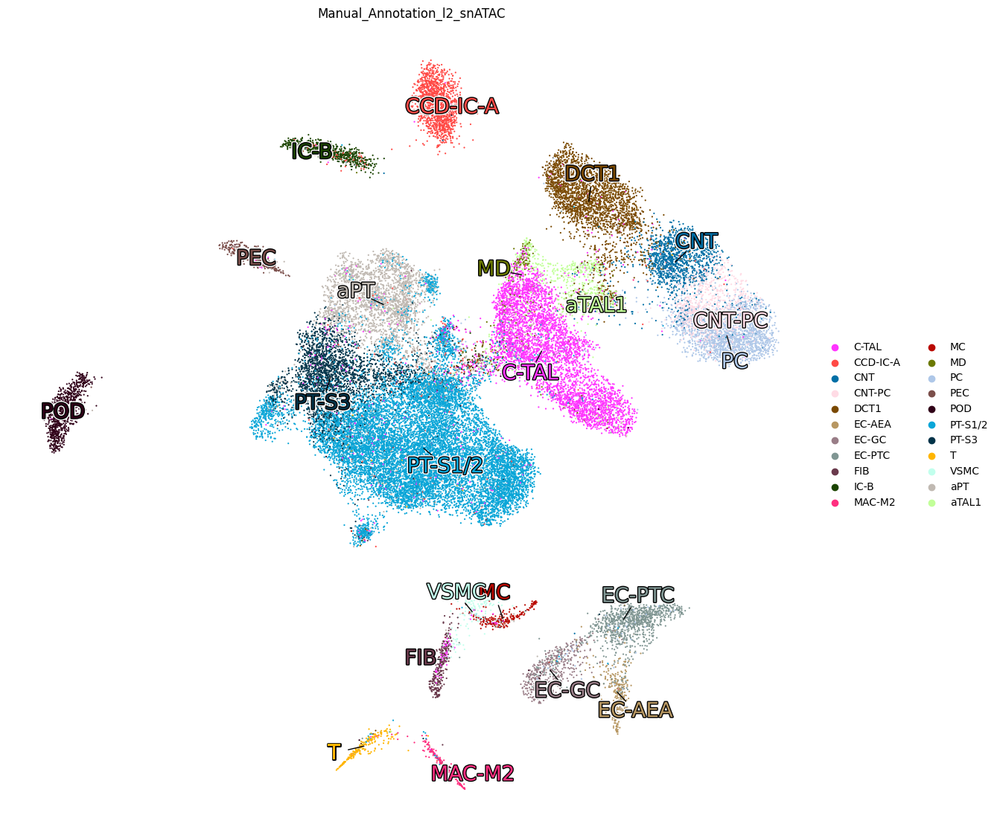

Figure size= (14, 14) dpi= 100.0 Scale factor = 44.981436429028804


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


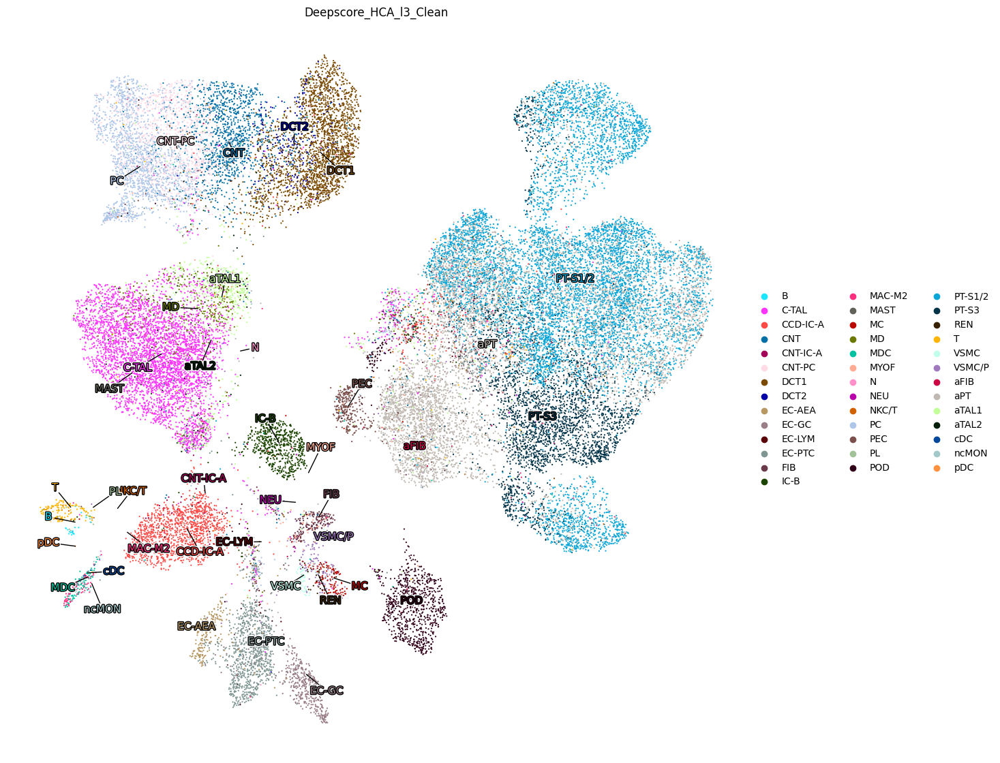

Figure size= (14, 14) dpi= 100.0 Scale factor = 44.981436429028804


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


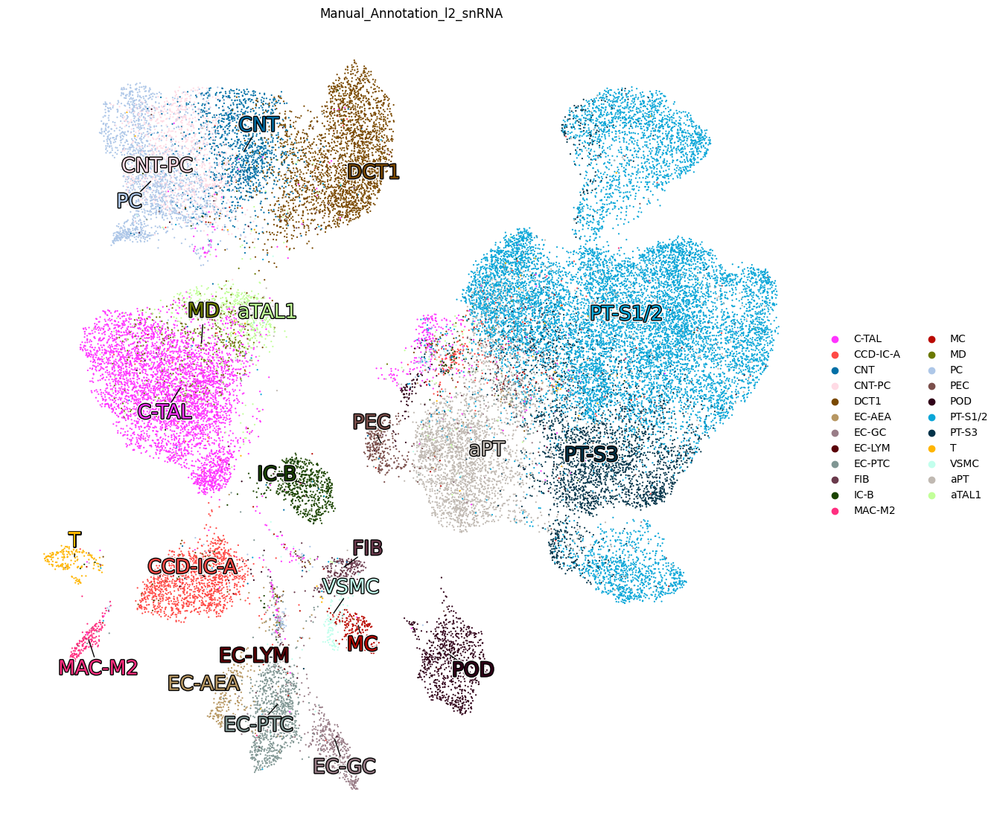

Figure size= (14, 14) dpi= 100.0 Scale factor = 44.981436429028804


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


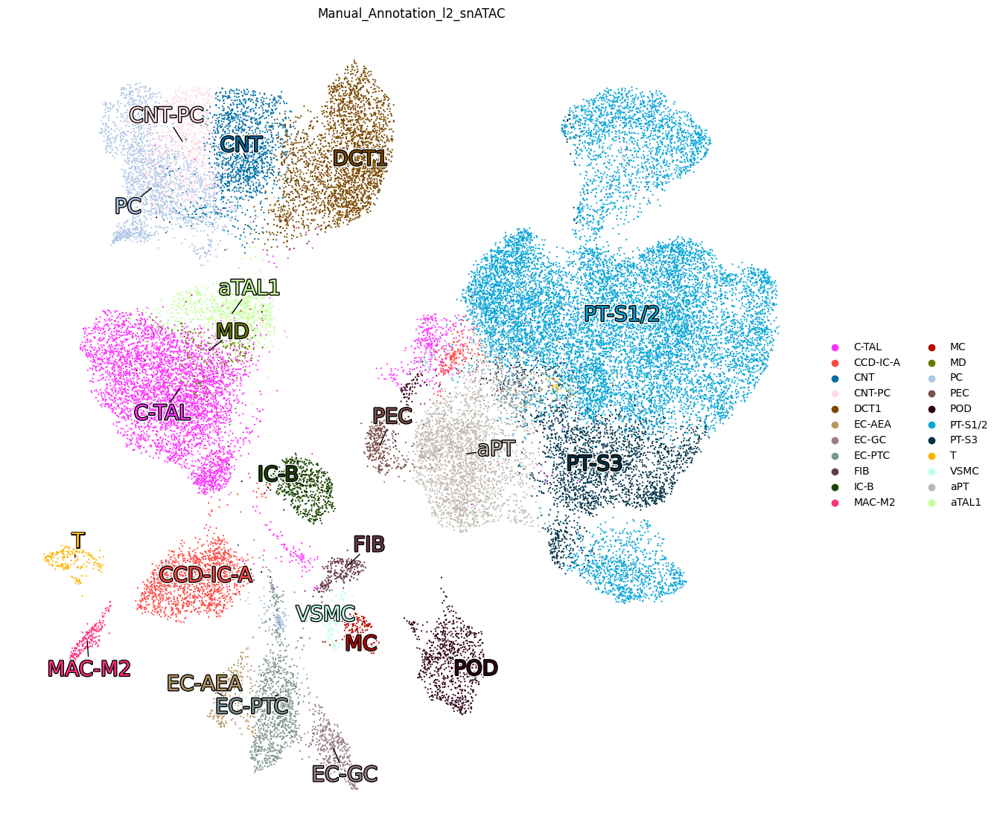

Figure size= (14, 14) dpi= 100.0 Scale factor = 44.900535653714385


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


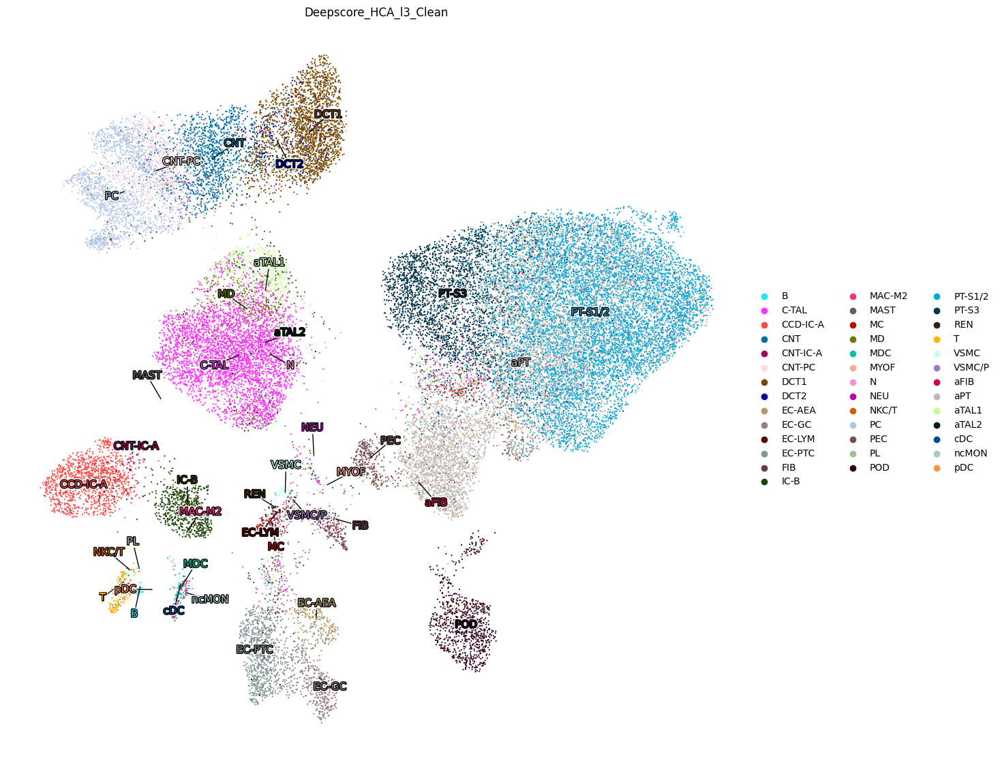

Figure size= (14, 14) dpi= 100.0 Scale factor = 44.900535653714385


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


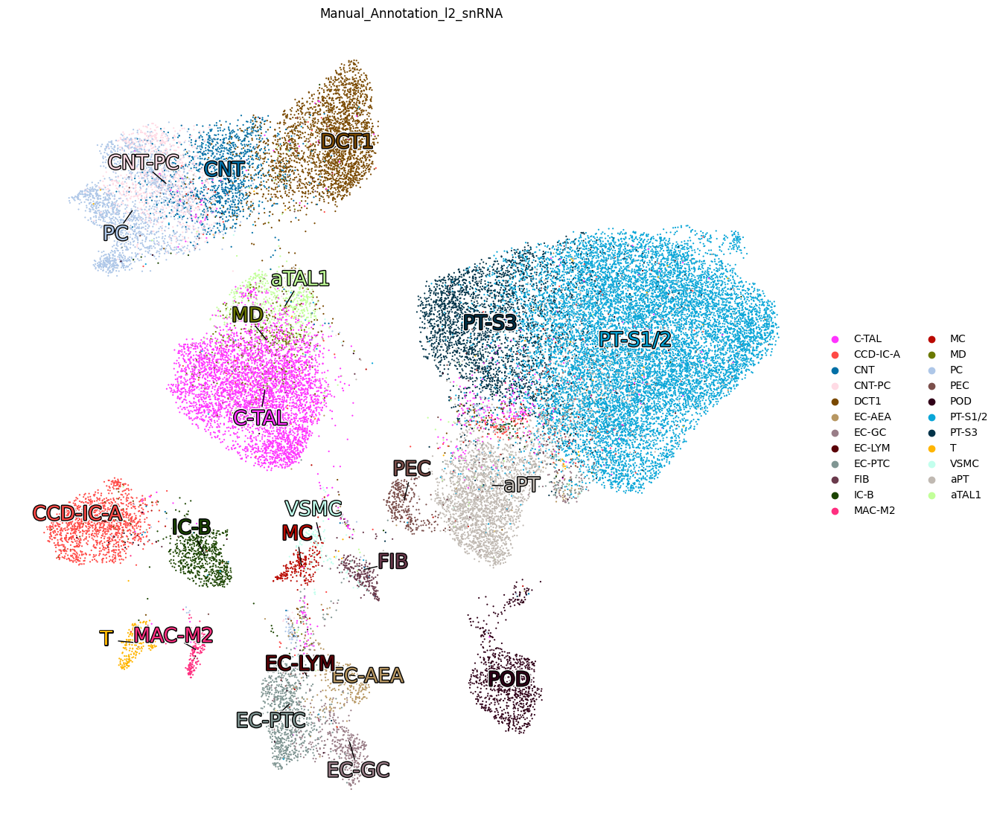

Figure size= (14, 14) dpi= 100.0 Scale factor = 44.900535653714385


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


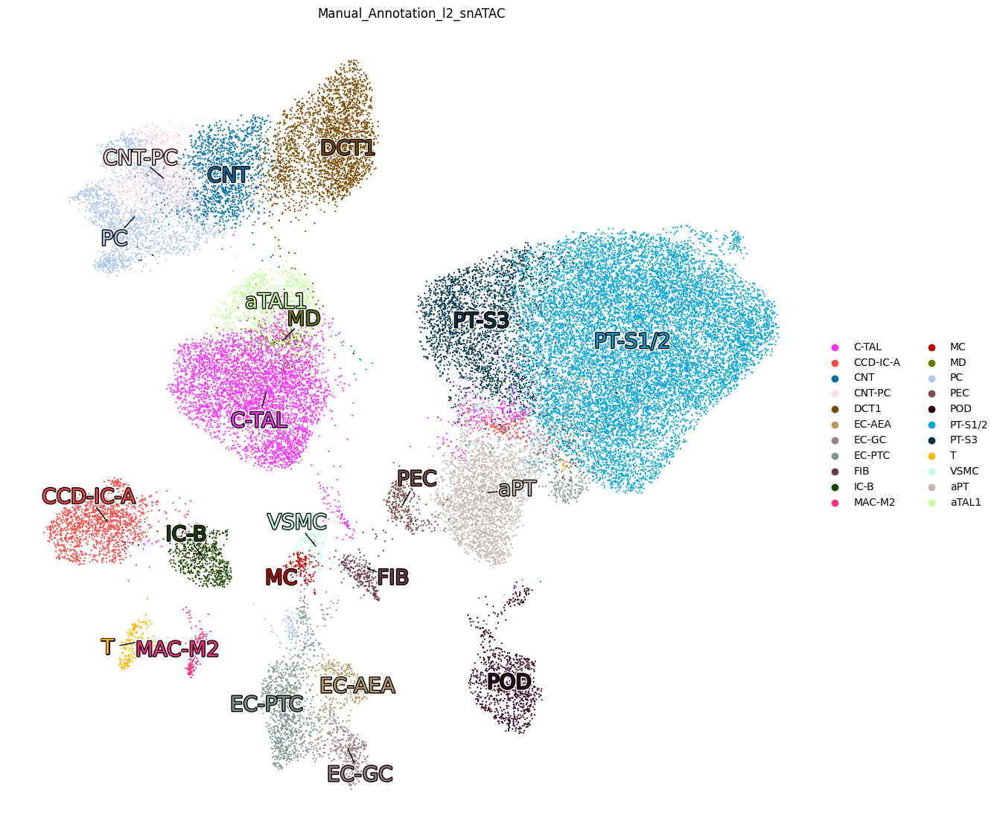

Figure size= (14, 14) dpi= 100.0 Scale factor = 45.82119542545403


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


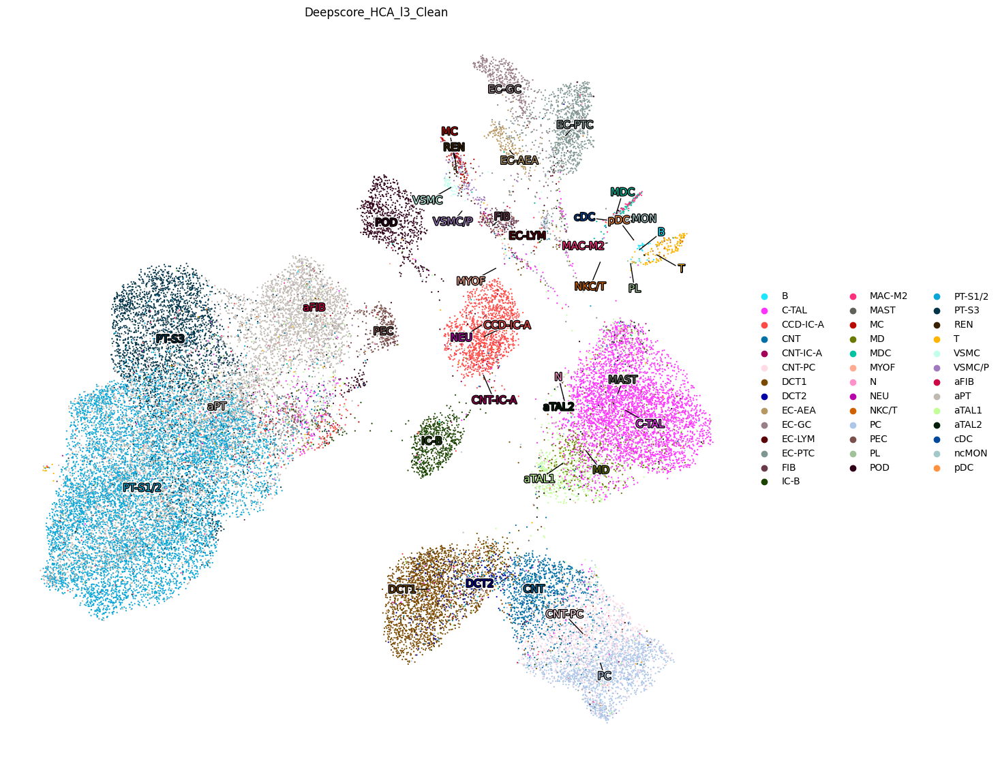

Figure size= (14, 14) dpi= 100.0 Scale factor = 45.82119542545403


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


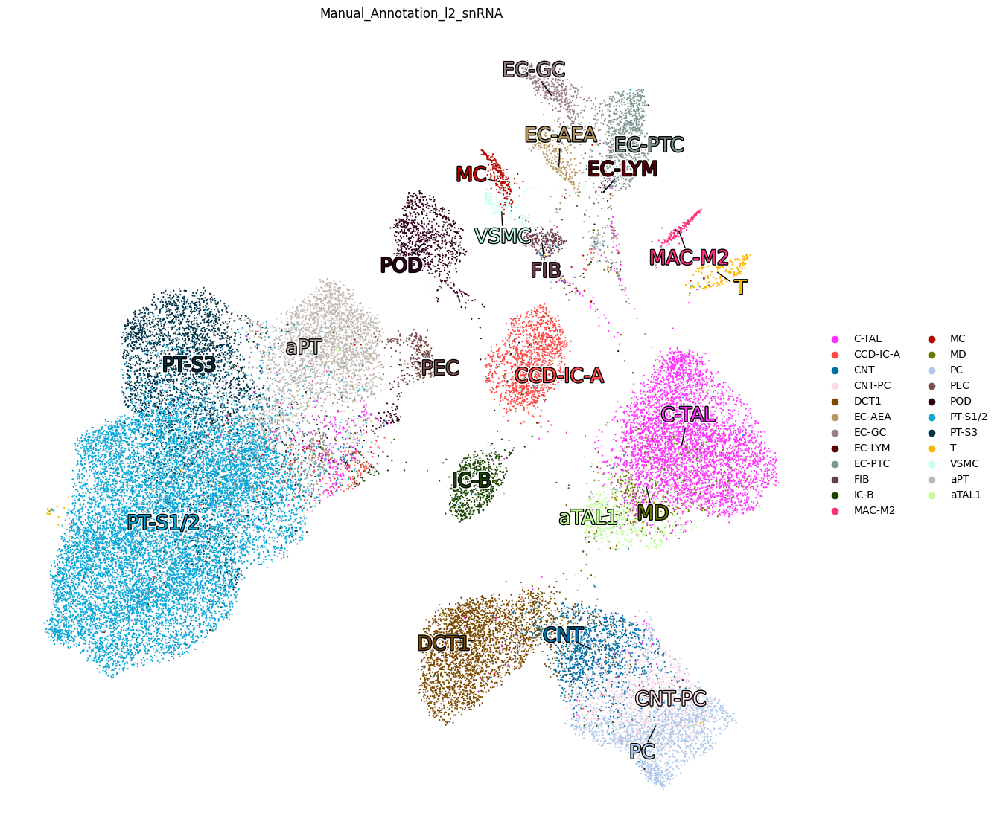

Figure size= (14, 14) dpi= 100.0 Scale factor = 45.82119542545403


/home/macera/Documentos/CZI/MANUSCRIPT_PREP/MANUSCRIPT_CODE/COMPARISON_FRAMEWORK/HORIZONTAL/ATAC/../../../utils/utils.py:104: RuntimeWarning: invalid value encountered in divide
  norm_direction = direction / np.linalg.norm(direction)


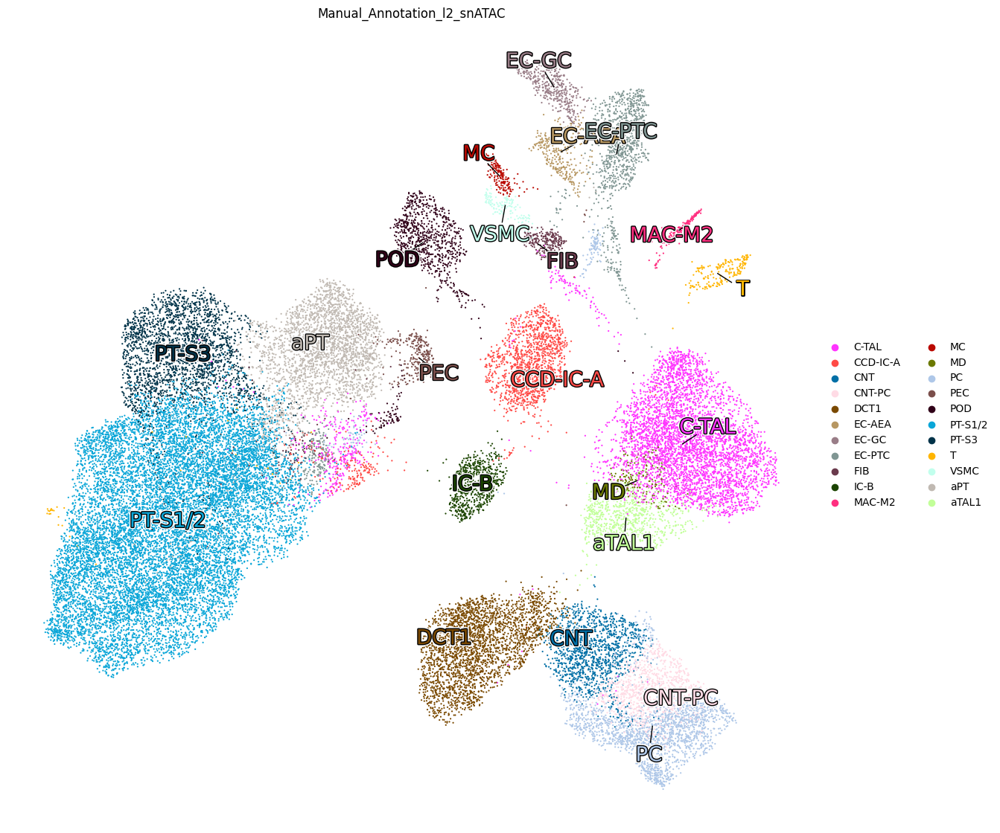

In [ ]:
for latent in ['PeakVI','PoissonVI','PoissonVI_fragments','ATAC_LSI_Seurat_WNN','Spectral','Spectral_Harmony','Spectral_mnn']:
    for ann in ['Deepscore_HCA_l3_Clean','Manual_Annotation_l2_snRNA','Manual_Annotation_l2_snATAC']:
        adata.uns[f'{ann}_colors'] = [l3_colors[i] for i in adata.obs[ann].cat.categories]
        umap_refined(adata,
                    umap = f'Umap_{latent}',
                    var = ann,
                    size= 10,
                    label_size = 35 * (50/len(adata.obs[ann].unique())),
                    width_in_inches = 14,
                    height_in_inches = 14,
                    max_iterations=7)
        plt.savefig(f'figures/UMAP_{ann}_{latent}.png',  bbox_inches='tight', dpi=300)
        plt.show()

In [13]:
adata = atac

In [7]:
atac = sc.read('../../../../HORIZONTAL_ATAC/objects/atac_multi.h5ad', compression='gzip')